In [1]:
%matplotlib widget
import torch 
import os
os.environ['TORCH_CUDA_ARCH_LIST'] = f'{torch.cuda.get_device_properties(0).major}.{torch.cuda.get_device_properties(0).minor}'

from diffSPH.v2.parameters import parseDefaultParameters, parseModuleParameters
from diffSPH.v2.sampling import sampleParticles
from diffSPH.v2.util import countUniqueEntries, printState
from diffSPH.v2.plotting import updatePlot, visualizeParticles, prepVisualizationState

from diffSPH.v2.modules.integration import integrate
from diffSPH.v2.modules.neighborhood import neighborSearch
from diffSPH.v2.modules.shifting import solveShifting
from diffSPH.v2.modules.timestep import computeTimestep

from diffSPH.v2.simulationSchemes.deltaPlus import simulationStep    
from diffSPH.v2.modules.viscosity import computeViscosityParameter, setViscosityParameters
from tqdm.autonotebook import tqdm
import matplotlib.pyplot as plt
import numpy as np
import torch
import copy
import os
import datetime
from diffSPH.v2.util import computeStatistics
import tomli

In [2]:
import scipy.sparse as sp
import scipy
import numpy as np

In [3]:
configurationFile = './configurations/01_tgv.toml'

with open(configurationFile, 'r') as f:
    config = f.read()

config = tomli.loads(config)

In [66]:
nx = 128
L = 1
u_mag = 2
k = 1 * np.pi
TGV_override = False
targetRe = 2000

config['domain']['minExtent'] = -L
config['domain']['maxExtent'] =  L
config['simulation'] = {'correctArea': True}

config['particle'] = {'nx' : nx}
config['fluid'] = {'cs' : u_mag * 10}
config['compute'] = {'device': 'cuda'}
config['plot']['export'] = True
config['kernel'] = {'name': 'Wendland4'}
# config['kernel']['targetNeighbors'] = 100
# config['compute'] = {'device': 'cpu'}

config = parseDefaultParameters(config)
config = parseModuleParameters(config)
setViscosityParameters(config, targetRe, L, u_mag)
config['integration']['scheme'] = 'symplecticEuler'
config['integration']['scheme'] = 'semiImplicitEuler'

# print(config['kernel'])

print(rf'Re = {config["diffusion"]["Re"]}, $\nu_{{sph}} = {config["diffusion"]["nu_sph"]}$, $\alpha = {config["diffusion"]["alpha"]}$')


$\alpha = 0.009433431170699188$ is very low, consider increasing the value (should be > 0.01)
Re = 2000.0, $\nu_{sph} = 0.002$, $\alpha = 0.009433431170699188$


In [67]:
config['diffusion']

{'velocityScheme': 'deltaSPH_inviscid',
 'delta': 0.1,
 'densityScheme': 'deltaSPH',
 'nu': 0.01,
 'alpha': 0.009433431170699188,
 'beta': 0.0,
 'pi-switch': False,
 'artificial-constant': 0.02,
 'eps': 1e-06,
 'nu_sph': 0.002,
 'Re': 2000.0}

In [68]:

from torch.profiler import profile, record_function, ProfilerActivity
from diffSPH.v2.modules.inletOutlet import processInlet, processOutlet, processForcing
from diffSPH.v2.plotting import plotRegions
from diffSPH.v2.sdf import getSDF, sdfFunctions, operatorDict
from diffSPH.v2.sampling import find_contour

ngrid = 255
x = torch.linspace(config['domain']['minExtent'][0], config['domain']['maxExtent'][0], ngrid, dtype = torch.float32)
y = torch.linspace(config['domain']['minExtent'][1], config['domain']['maxExtent'][1], ngrid, dtype = torch.float32)
X, Y = torch.meshgrid(x, y, indexing = 'ij')
P = torch.stack([X,Y], dim=-1)
points = P.reshape(-1,2)


sphere_b = lambda points: getSDF('box')['function'](points, torch.tensor([1/8,1/2]).to(points.device))
inletSDF = operatorDict['translate'](sphere_b, torch.tensor([-2 + 1/8,0.]))
# fx = sdf(torch.clone(points)).to('cpu').reshape(ngrid,ngrid)


sphere_b = lambda points: getSDF('box')['function'](points, torch.tensor([1/8,1]).to(points.device))
outletSDF = operatorDict['translate'](sphere_b, torch.tensor([2 - 1/8,0.]))
# fx = sdf(torch.clone(points)).to('cpu').reshape(ngrid,ngrid)

sphere_b = lambda points: getSDF('box')['function'](points, torch.tensor([1/4,1.5]).to(points.device))
outletRegion = operatorDict['translate'](sphere_b, torch.tensor([2 - 1/4,0.]))
# fx = sdf(torch.clone(points)).to('cpu').reshape(ngrid,ngrid)

inner = lambda points: getSDF('box')['function'](points, torch.tensor([1,1]).to(points.device))
outer = lambda points: getSDF('box')['function'](points, torch.tensor([1 + config['particle']['dx'] * boundary_width,1 + config['particle']['dx'] * boundary_width]).to(points.device))
outer = operatorDict['invert'](outer)
sdf = operatorDict['union'](inner, outer)
boundary_sdf = operatorDict['invert'](inner)


fluid_sdf = lambda points: getSDF('box')['function'](points, torch.tensor([1,1]).to(points.device))
# fluid_sdf = operatorDict['translate'](sphere_b, torch.tensor([-2 + 1/2, - 1/2]))


regions = [
{
        'sdf': fluid_sdf,
        'type': 'fluid',
        'velocity': torch.tensor([0.,0.]),
        # 'particles': sampleParticles(config, sdfs = [fluid_sdf])[0],
        'contour': find_contour(fluid_sdf(points).reshape(ngrid, ngrid).cpu(), config['domain']['minExtent'].cpu(), config['domain']['maxExtent'].cpu(), ngrid, 0)
    }
    ]

config['regions'] = regions


In [69]:
from diffSPH.v2.sampling import sampleNoisyParticles
from diffSPH.v2.modules.divergence import computeDivergence
from diffSPH.v2.plotting import plotSDF
from diffSPH.v2.sdf import getSDF, operatorDict

# particleState, mask = sampleParticles(config, sdfs = [])
particleState, mask = sampleNoisyParticles(config['noise'], config, sdfs = regions, randomizeParticles = False)

priorState = None
# particleState['velocities'][:,0] =  u_mag * torch.cos(k * particleState['positions'][:,0]) * torch.sin(k * particleState['positions'][:,1])
# particleState['velocities'][:,1] = -u_mag * torch.sin(k * particleState['positions'][:,0]) * torch.cos(k * particleState['positions'][:,1])

# u_max = torch.linalg.norm(particleState['velocities'], dim = 1).max()
# particleState['velocities'] = particleState['velocities'] / (u_max + 1e-7) * u_mag
Ek0 = 0.5 * particleState['areas'] * particleState['densities'] * torch.linalg.norm(particleState['velocities'], dim = -1)**2

initialVelocities = particleState['velocities'].clone()

particleState['Eks'] =  (0.5 * particleState['areas'] * particleState['densities'] * torch.linalg.norm(initialVelocities, dim = -1)**2)
particleState['E_k'] = particleState['Eks'].sum().cpu().detach().item()



In [70]:
from diffSPH.v2.simulationSchemes.dfsph import simulationStep
from diffSPH.v2.modules.momentumEquation import computeMomentumEquation
from diffSPH.v2.modules.neighborhood import searchNeighbors
from diffSPH.v2.simulationSchemes.dfsph import callModule, computeDensity, computeGravity, computeViscosity, sphOperationStates, scatter_sum
from diffSPH.v2.modules.incompressible import computeDivergence, projectVelocities, computePressureAcceleration, solveIncompressible_relaxedJacobi, simulationStep
from diffSPH.v2.plotting import prepVisualizationState, visualizeParticleQuantity
from diffSPH.v2.plotting import exportPlot, postProcessPlot


from diffSPH.v2.sampling import generateInitialConditions

# initialState = generateInitialConditions(particleState, config)
initialState = {
    'fluid': particleState,
    'time': 0.0,
    'timestep': 0,
    'dt': torch.tensor(5e-4, device = config['compute']['device']),
}

# initialState['fluid']['velocities'][:,0] =  u_mag * torch.cos(k * initialState['fluid']['positions'][:,0]) * torch.sin(k * initialState['fluid']['positions'][:,1])
# initialState['fluid']['velocities'][:,1] = -u_mag * torch.sin(k * initialState['fluid']['positions'][:,0]) * torch.cos(k * initialState['fluid']['positions'][:,1])


# perennialState = copy.deepcopy(initialState)
config['dfsph']['maxIters'] = 512
config['dfsph']['errorThreshold'] = 5e-4
config['dfsph']['omega'] = 0.33

config['timestep']['dt'] = 1e-3
# perennialState['dt'] = 1e-3

# priorState = None
# perennialState, priorState, *updates = integrate(simulationStep, perennialState, config, previousStep= priorState)
# perennialState['time'] += perennialState['dt']

# searchNeighbors(perennialState, config)
# div = computeMomentumEquation(perennialState['fluid'], perennialState['fluid'], perennialState['fluid']['neighborhood'], config)

In [71]:
solverState = copy.deepcopy(initialState)

# solverState['fluid']['positions'] += 1e-2 * torch.randn_like(solverState['fluid']['positions'])

# solverState['fluid']['velocities'][:,0] =  u_mag * torch.cos(k * solverState['fluid']['positions'][:,0]) * torch.sin(k * solverState['fluid']['positions'][:,1])
# solverState['fluid']['velocities'][:,1] = -u_mag * torch.sin(k * solverState['fluid']['positions'][:,0]) * torch.cos(k * solverState['fluid']['positions'][:,1])

searchNeighbors(solverState, config)

solverState['fluid']['densities'], _ =  callModule(solverState, computeDensity, config, 'fluid')

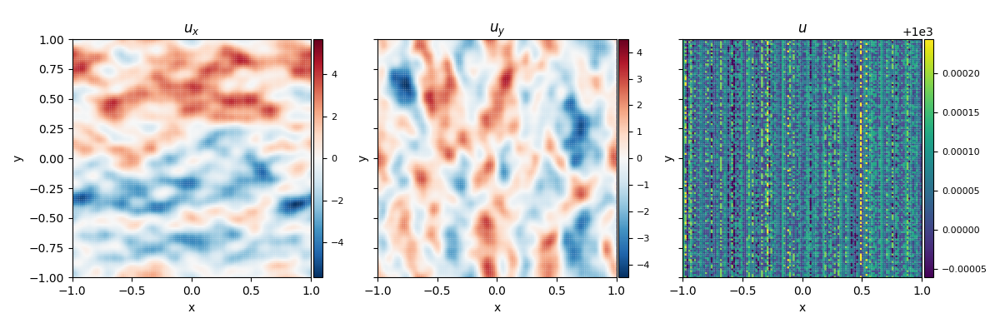

In [72]:
fig, axis = plt.subplots(1,3, figsize = (12,4), squeeze = False, sharey = True)


visualizationState = prepVisualizationState(solverState, config, grid = True)
# plotRegions(regions, axis[0,0])
# plotRegions(regions, axis[0,1])

s = 1
div = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)


pressurePlot = visualizeParticleQuantity(fig, axis[0,0], config, visualizationState, quantity =
                                      'velocities',
                                      mapping = '.x', s = s, 
                          scaling = 'sym', gridVisualization=False, cmap = 'RdBu_r', title = '$u_x$', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
rhoPlot = visualizeParticleQuantity(fig, axis[0,1], config, visualizationState, quantity = 
                                      'velocities',
                                      mapping = '.y', s = s, 
                          scaling = 'sym', gridVisualization=False, cmap = 'RdBu_r', streamLines = False, operation = None, title = '$u_y$', plotBoth = False, which = 'fluid', midPoint = 0)
velPlot = visualizeParticleQuantity(fig, axis[0,2], config, visualizationState, quantity = 
                                      'densities' ,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'viridis', streamLines = False, operation = None, title = '$u$', plotBoth = False, which = 'fluid', midPoint = 0)


fig.tight_layout()

In [74]:
solverState['fluid']['advection'] = torch.zeros_like(solverState['fluid']['velocities'])


# p_starstar, iters_inc, errors, pressures, sourceTerm = solveIncompressible_relaxedJacobi(solverState['fluid'], solverState['fluid'], config, solverState['dt'], neighborhood=solverState['fluid']['neighborhood'])

In [75]:
config['shifting']

{'scheme': 'IPS',
 'threshold': 0.1,
 'maxIterations': 1,
 'freeSurface': False,
 'R': 0.25,
 'n': 4,
 'CFL': 1.5,
 'computeMach': True,
 'solver': 'BiCGStab_wJacobi',
 'normalScheme': 'lambda',
 'projectionScheme': 'mat',
 'surfaceScaling': 0.1,
 'summationDensity': False,
 'useExtendedMask': False,
 'initialization': 'zero',
 'maxSolveIter': 256,
 'surfaceDetection': 'Barcasco',
 'active': True}

In [76]:
config['shifting']['scheme'] = 'IPS'
config['shifting']['maxIterations'] = 16
config['shifting']['summationDensity'] = True
config['shifting']['threshold'] = 0.05

In [77]:
newState = copy.deepcopy(solverState)

dx, states = solveShifting(newState, config)

newState['fluid']['positions'] += dx

searchNeighbors(newState, config)

newState['fluid']['densities'], _ =  callModule(newState, computeDensity, config, 'fluid')
rho = newState['fluid']['densities']
# newState['fluid']['velocities'][:,0] =  u_mag * torch.cos(k * newState['fluid']['positions'][:,0]) * torch.sin(k * newState['fluid']['positions'][:,1])
# newState['fluid']['velocities'][:,1] = -u_mag * torch.sin(k * newState['fluid']['positions'][:,0]) * torch.cos(k * newState['fluid']['positions'][:,1])


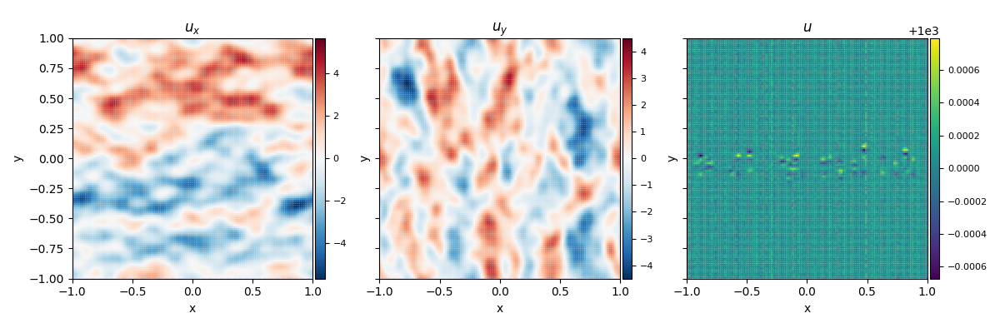

In [78]:
fig, axis = plt.subplots(1,3, figsize = (12,4), squeeze = False, sharey = True)


visualizationState = prepVisualizationState(newState, config, grid = True)
# plotRegions(regions, axis[0,0])
# plotRegions(regions, axis[0,1])

s = 1
div = computeDivergence(newState['fluid'], newState['fluid'], newState['fluid']['neighborhood'], config)


pressurePlot = visualizeParticleQuantity(fig, axis[0,0], config, visualizationState, quantity =
                                      'velocities',
                                      mapping = '.x', s = s, 
                          scaling = 'sym', gridVisualization=False, cmap = 'RdBu_r', title = '$u_x$', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
rhoPlot = visualizeParticleQuantity(fig, axis[0,1], config, visualizationState, quantity = 
                                      'velocities',
                                      mapping = '.y', s = s, 
                          scaling = 'sym', gridVisualization=False, cmap = 'RdBu_r', streamLines = False, operation = None, title = '$u_y$', plotBoth = False, which = 'fluid', midPoint = 0)
velPlot = visualizeParticleQuantity(fig, axis[0,2], config, visualizationState, quantity = 
                                      'densities' ,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'viridis', streamLines = False, operation = None, title = '$u$', plotBoth = False, which = 'fluid', midPoint = 0)


fig.tight_layout()

In [79]:

def computeDivergence(stateA, stateB, neighborhood, simConfig, key="velocities"):
    with record_function("[SPH] - Fluid Divergence ($nabla cdot \\bar{v}$)"):
        divergence = -sphOperationStates(
            stateA,
            stateB,
            (stateA[key], stateB[key]),
            neighborhood=neighborhood,
            operation="divergence",
            gradientMode = 'difference',
        )
        return divergence


from typing import Union
# @torch.jit.script 
def gradientOp(
        masses : tuple[torch.Tensor, torch.Tensor],                                 # Tuple of particle masses for (i,j)
        densities : tuple[torch.Tensor, torch.Tensor],                              # Tuple of particle densities for (i,j)
        quantities : Union[torch.Tensor, tuple[torch.Tensor, torch.Tensor]],                             # Tuple of particle quantities for (i,j)
        neighborhood : tuple[torch.Tensor, torch.Tensor], gradKernels : torch.Tensor,   # Neighborhood information (i,j) and precomupted kernels ij
        numParticles : int, type : str = 'naive'):    # Ancillary information
    i = neighborhood[0]                                                    
    j = neighborhood[1]

    k = masses[1][j].view(-1,1) * gradKernels
    Ai = torch.einsum('n..., n -> n...', quantities[0][i], 1.0 / densities[0][i]**2)
    Aj = torch.einsum('n..., n -> n...', quantities[1][j], 1.0 / densities[1][j]**2)
    kq = torch.einsum('n... , nd -> n...d', Ai + Aj, k)

    print('grad', Ai.shape, Aj.shape, kq.shape, k.shape)

    return torch.einsum('n, n... -> n...', densities[0], scatter_sum(kq, i, dim = 0, dim_size = numParticles))


def computeAlpha(stateA, stateB, config, neighborhood, dt, actualAreas):

    fluidNeighbors = neighborhood  # simulationState['fluid']['neighborhood']
    (i, j) = fluidNeighbors['indices']

    grad = fluidNeighbors['gradients']
    grad2 = torch.einsum('nd, nd -> n', grad, grad)

    term1 = actualAreas[1][j][:,None] * grad
    term2 = (actualAreas[1]**2 / (stateB['areas'] * config['fluid']['rho0']))[j] * grad2

    kSum1 = scatter_sum(term1, i, dim=0, dim_size=stateA['areas'].shape[0])
    kSum2 = scatter_sum(term2, i, dim=0, dim_size=stateA['areas'].shape[0])

    fac = - dt* dt * actualAreas[0]
    mass = stateA['areas'] * config['fluid']['rho0']
    alpha = fac / mass * torch.einsum('nd, nd -> n', kSum1, kSum1) + fac * kSum2
    # alpha = torch.clamp(alpha, -1, -1e-7)

    # alpha = alpha * dt
    return alpha# /3#* config['fluid']['rho0'] #/ dt


def computePressureAcceleration(stateA, stateB, config, neighborhood, pressure):
    # sphOperationStates(solverState['fluid'], solverState['fluid'], (p_starstar, p_starstar), operation = 'gradient', gradientMode='symmetric', neighborhood= solverState['fluid']['neighborhood'])
    return -sphOperationStates(
        stateA,
        stateB,
        (pressure[0], pressure[1]),
        operation="gradient",
        gradientMode="summation",
        neighborhood=neighborhood,
    # ) /  config['fluid']['rho0']# stateA["densities"].view(-1, 1)
    ) /  stateA["densities"].view(-1, 1)
    # ) / stateA["densities"].view(-1, 1) # config['fluid']['rho0'] ## stateA["densities"].view(-1, 1)


def updatePressure(
    stateA,
    stateB,
    config,
    neighborhood,
    dt,
    pressures,
    pressureAccels,
    sourceTerms,
    alphas,
):
    # print(dt)
    kernelSum = - dt * dt  * sphOperationStates(
        stateA,
        stateB,
        (pressureAccels[0], pressureAccels[1]),
        operation="divergence",
        gradientMode="difference",
        neighborhood=neighborhood,
    )

    sourceTerm = sourceTerms[0]

    kernelSum = kernelSum #* config['fluid']['rho0']
    alpha = alphas[0]#* config['fluid']['rho0']* 2

    residual = kernelSum - sourceTerm
    pressure = pressures[0] + 0.5 * (sourceTerm -  kernelSum) / ( alpha)# / dt

    pressure[torch.isinf(pressure)] = 0
    pressure[torch.isnan(pressure)] = 0
    pressure[pressure.abs() > 1e10] = 0

    pressure = pressure - pressure.mean()

    # print(f'pressure.max(): {pressure.max()} | pressure.min(): {pressure.min()} | pressure.mean(): {pressure.mean()}')
    # print(f'kernelSum.max(): {kernelSum.max()} | kernelSum.min(): {kernelSum.min()} | kernelSum.mean(): {kernelSum.mean()}')
    # print(f'sourceTerm.max(): {sourceTerm.max()} | sourceTerm.min(): {sourceTerm.min()} | sourceTerm.mean(): {sourceTerm.mean()}')
    # print(f'residual.max(): {residual.max()} | residual.min(): {residual.min()} | residual.mean(): {residual.mean()}')
    # print(f'alpha.max(): {alpha.max()} | alpha.min(): {alpha.min()} | alpha.mean(): {alpha.mean()}')

    # if config['dfsph']['clampPressure']:
    # pressure = torch.max(pressure, torch.zeros_like(pressure))

    return pressure, residual

from diffSPH.kernels import getKernel

def solveIncompressible_relaxedJacobi(stateA, stateB, config, dt, neighborhood):
    neighborDict = copy.copy(neighborhood)

    rij = neighborDict['distances']
    xij = neighborDict['vectors']
    hij = neighborDict['supports']

    dim = config['domain']['dim']
    kernel = config['kernel']['function']
    kernel = getKernel('Spiky')

    # neighborDict['kernels'] = kernel.kernel(rij, hij, dim)
    # neighborDict['gradients'] = kernel.kernelGradient(rij, xij, hij, dim) 
    

    # rho = sphOperationStates(stateA, stateB, quantities=None, operation="density", neighborhood=neighborDict)
    rho = stateA['densities']
    advectionVelocities = stateA["velocities"] + stateA["advection"] * dt

    advectionDivergence = -sphOperationStates(stateA, stateB, (advectionVelocities, advectionVelocities), neighborhood=neighborhood, operation="divergence",gradientMode="difference")

    actualArea = stateA["masses"] / rho
    # direct formulation
    rho_initial = rho
    rhoStar = rho_initial - rho_initial * dt * advectionDivergence

    # sourceTerm = (config['fluid']['rho0'] - rhoStar) / timestep
    # PBSPH formulation
    sourceTerm = (1 - stateA["areas"] / actualArea + dt**2 * advectionDivergence) #* config['fluid']['rho0']

    sourceTerm = sourceTerm - sourceTerm.mean()

    pressureA = torch.zeros(stateA["numParticles"], device=config["compute"]["device"])
    pressureB = torch.zeros(stateA["numParticles"], device=config["compute"]["device"])

    if "pressureIncompressible" in stateA:
        pressureB = 0.5 * stateA["pressureIncompressible"].clone()
        pressureA = 0.5 * stateA["pressureIncompressible"].clone()

    # print(f"Initial Density: {(rho - config['fluid']['rho0']).max()} | {(rho- config['fluid']['rho0']).min()} | {(rho- config['fluid']['rho0']).abs().mean()}")
    # print(f"Predicted Density: {(rhoStar- config['fluid']['rho0']).max()} | {(rhoStar- config['fluid']['rho0']).min()} | {(rhoStar- config['fluid']['rho0']).abs().mean()}")
    # print(f"Source Term: {sourceTerm.max()} | {sourceTerm.min()} | {sourceTerm.abs().mean()}")
    # print(f"Advection Divergence: {advectionDivergence.abs().max()} | {advectionDivergence.abs().min()} | {advectionDivergence.mean()}")

    errors = []
    pressures = []
    i = 0
    error = 0.0
    minIters = 2  # config['dfsph']['minIters']
    maxIters = 256  # config['dfsph']['maxIters']
    errorThreshold = 5e-4  # config['dfsph']['errorThreshold']
    errorThreshold = 5e-4
    errorThreshold = 5e-4

    alpha = computeAlpha(stateA, stateB, config, neighborhood, dt=dt, actualAreas=(actualArea, actualArea))  # / fac
    # print(f"Alpha: {alpha.max()} | {alpha.min()} | {alpha.mean()}")

    alpha = alpha *3 #00 #* 10
    # alpha += torch.randn_like(alpha) * torch.abs(alpha) * 1e-4
    minResidual = 1e10

    while i < maxIters and (i < minIters or error > errorThreshold):
        pressureAccel = computePressureAcceleration(
            stateA, stateB, config, neighborDict, (pressureB, pressureB)
        )
        pressureA[:] = pressureB.clone()

        pressureB, residual = updatePressure( stateA, stateB, config, neighborDict, dt=dt, pressures=(pressureA, pressureA), pressureAccels=(pressureAccel, pressureAccel), sourceTerms=(sourceTerm, sourceTerm), alphas=(alpha, alpha))
        # if config['dfsph']['sourceTerm'] == 'density':
        # stateA['pressureB'] = torch.max(stateA['pressureB'], torch.zeros_like(stateA['pressureB']))
        # error = torch.mean(torch.clamp(stateA['residual'], min = -errorThreshold))

        error = torch.mean(torch.clamp(residual.abs(), min=-errorThreshold))  # / config['fluid']['rho0']

        errors.append(error.detach().cpu().item())
        # print(f"\tPS: {i:2d} -> {error.detach().cpu().item():+.4e}, pressure mean: {pressureB.mean().detach().cpu().item():+.4e}, pressure accel mean: {torch.linalg.norm(pressureAccel, dim=-1).mean().detach().cpu().item():+.4e}, pressure min: {pressureB.min()} max: {pressureB.max()}")
        # break
        pressures.append(pressureB.mean().detach().cpu().item())
        newResidual = residual.abs().mean()
        if newResidual < minResidual:
            minResidual = newResidual
        elif newResidual > 1.5 * minResidual:
            pressureB[:] = pressureA.clone()
            print(f"\tInstability in convergence!!")
            break

        i += 1
    pressureAccel = computePressureAcceleration(
        stateA, stateB, config, neighborDict, (pressureB, pressureB)
    )
    return pressureB, i, errors, pressures, sourceTerm, pressureAccel


def solveDivergenceFree_relaxedJacobi(stateA, stateB, config, dt, neighborhood):
    # areaScale = config['particle']['dx']


    neighborDict = copy.copy(neighborhood)

    rij = neighborDict['distances']
    xij = neighborDict['vectors']
    hij = neighborDict['supports']

    dim = config['domain']['dim']
    kernel = config['kernel']['function']
    kernel = getKernel('Spiky')

    # neighborDict['kernels'] = kernel.kernel(rij, hij, dim)
    # neighborDict['gradients'] = kernel.kernelGradient(rij, xij, hij, dim) 
    

    rho = sphOperationStates(stateA, stateB, quantities=None, operation="density", neighborhood=neighborhood)
    advectionVelocities = stateA["velocities"] + stateA["advection"] * dt

    advectionDivergence = -sphOperationStates(stateA, stateB, (advectionVelocities, advectionVelocities), neighborhood=neighborDict, operation="divergence",gradientMode="difference")

    actualArea = stateA["masses"] / rho
    # direct formulation
    rho_initial = rho
    rhoStar = rho_initial - rho_initial * dt * advectionDivergence

    # sourceTerm = (config['fluid']['rho0'] - rhoStar) / timestep
    # PBSPH formulation
    sourceTerm = 1 - stateA["areas"] / actualArea + dt * advectionDivergence
    sourceTerm = advectionDivergence #* dt #* config['fluid']['rho0']

    pressureA = torch.zeros(stateA["numParticles"], device=config["compute"]["device"])
    pressureB = torch.zeros(stateA["numParticles"], device=config["compute"]["device"])

    # if "pressure" in stateA:
        # pressureB = 0.5 * stateA["pressure"].clone()
        # pressureA = 0.5 * stateA["pressure"].clone()

    # print(f"Initial Density: {rho.abs().max()} | {rho.abs().min()} | {rho.mean()}")
    # print(f"Predicted Density: {rhoStar.abs().max()} | {rhoStar.abs().min()} | {rhoStar.mean()}")
    # print(f"Source Term: {sourceTerm.abs().max()} | {sourceTerm.abs().min()} | {sourceTerm.abs().mean()}")

    errors = []
    pressures = []
    i = 0
    error = 0.0
    minIters = 16  # config['dfsph']['minIters']
    maxIters = 16  # config['dfsph']['maxIters']
    # errorThreshold = 5e-4  # config['dfsph']['errorThreshold']
    # errorThreshold = 8.5e-5
    errorThreshold = 1e-4

    alpha = computeAlpha(stateA, stateB, config, neighborDict, dt=dt, actualAreas=(actualArea, actualArea))  # / fac
        # print(f"Alpha: {alpha.max()} | {alpha.min()} | {alpha.mean()}")
    alpha = alpha #* 1000#00
    previousResidual = sourceTerm
    while i < maxIters and (i < minIters or error > errorThreshold):
        pressureAccel = computePressureAcceleration(
            stateA, stateB, config, neighborDict, (pressureB, pressureB)
        )
        pressureA[:] = pressureB.clone()

        pressureB, residual = updatePressure( stateA, stateB, config, neighborDict, dt=dt, pressures=(pressureA, pressureA), pressureAccels=(pressureAccel, pressureAccel), sourceTerms=(sourceTerm, sourceTerm), alphas=(alpha, alpha))
        # if config['dfsph']['sourceTerm'] == 'density':
        # stateA['pressureB'] = torch.max(stateA['pressureB'], torch.zeros_like(stateA['pressureB']))
        # error = torch.mean(torch.clamp(stateA['residual'], min = -errorThreshold))

        error = torch.mean(torch.clamp(residual.abs(), min=-errorThreshold))  # / config['fluid']['rho0']

        errors.append(error.detach().cpu().item())
        print(f"DF: {i:2d} -> {error.detach().cpu().item()}, pressure mean: {pressureB.mean().detach().cpu().item():+.4e}, pressure accel mean: {torch.linalg.norm(pressureAccel, dim=-1).mean().detach().cpu().item():+.4e} pressure: {pressureB.min()} {pressureB.max()}")
        # break
        pressures.append(pressureB.mean().detach().cpu().item())

        # if error < previousResidual.abs().mean():
        #     previousResidual = residual
        #     alpha = alpha * 0.9
        #     # print(f'decreasing alpha [{error} | {previousResidual.abs().mean()}] {pressureB.min()} {pressureB.max()}')
        # else:
        #     alpha = alpha * 1.1
            # print(f'increasing alpha [{error} | {previousResidual.abs().mean()}] {pressureB.min()} {pressureB.max()}')
            # pressureB = pressureA.clone()

        i += 1
    # print(pressureA, pressureB)
    pressureAccel = computePressureAcceleration(
        stateA, stateB, config, neighborDict, (pressureA, pressureA)
    )
    return pressureB, i, errors, pressures, sourceTerm, pressureAccel, alpha



In [80]:
# config['diffusion']['alpha'] = 0.05

In [81]:

def computeDivergence(stateA, stateB, neighborhood, simConfig, key="velocities"):
    with record_function("[SPH] - Fluid Divergence ($nabla cdot \\bar{v}$)"):
        divergence = -sphOperationStates(
            stateA,
            stateB,
            (stateA[key], stateB[key]),
            neighborhood=neighborhood,
            operation="divergence",
            gradientMode = 'difference',
        )
        return divergence
    
def simulationStep(solverState, config):
    searchNeighbors(solverState, config)
    # print(f'#############################################################################################')
    # print(f'Start of simulation step')

    # Advection Step
    # solverState['fluid']['densities'], _ = callModule(solverState, computeDensity, config, 'fluid')
    solverState['fluid']['gravityAccel'] = computeGravity(solverState['fluid'], config)
    solverState['fluid']['velocityDiffusion'], _ = callModule(solverState, computeViscosity, config, 'fluid')

    # Divergence-Free Solver Preparation
    solverState['fluid']['advection'] = solverState['fluid']['gravityAccel'] + solverState['fluid']['velocityDiffusion']
    # solverState['fluid']['initialVelocities'] = solverState['fluid']['velocities'].clone()
    solverState['fluid']['advectionVelocities'] = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']

    divergence = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config, key='advectionVelocities')
    # solverState['fluid']['velocityDivergence'] = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)
    # solverState['fluid']['advectionDivergence'] = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config, key='advectionVelocities')

    # print(f'Density: {solverState["fluid"]["densities"].max()} | {solverState["fluid"]["densities"].min()} | {solverState["fluid"]["densities"].mean()}')
    # print(f'Gravity: {solverState["fluid"]["gravityAccel"].max()} | {solverState["fluid"]["gravityAccel"].min()} | {solverState["fluid"]["gravityAccel"].mean()}')
    # print(f'Viscosity: {solverState["fluid"]["velocityDiffusion"].max()} | {solverState["fluid"]["velocityDiffusion"].min()} | {solverState["fluid"]["velocityDiffusion"].mean()}')
    # print(f'Advection: {torch.linalg.norm(solverState["fluid"]["advection"], dim = -1).max()} | {torch.linalg.norm(solverState["fluid"]["advection"], dim = -1).min()} | {torch.linalg.norm(solverState["fluid"]["advection"], dim = -1).mean()}')
    
    v_star = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']
    # Could also use actual density here
    # rho = torch.ones_like(solverState['fluid']['densities']) * config['fluid']['rho0']  # solverState['fluid']['densities'].view(-1,1)

    # Solve Divergence-Free PPE
    # pressure_star, iters, residuals, convergence, B, accel_p_star, alpha = solveDivergenceFree_relaxedJacobi(solverState['fluid'], solverState['fluid'], config, solverState['dt'], neighborhood=solverState['fluid']['neighborhood'])
    # v_prime = v_star - accel_p_star * solverState['dt']  # / 10**3 
    # print(f'sourceTerm: {B.min()} | {B.max()} | {B.abs().mean()}')
    # print(f'Divergence before DF: {divergence.min()} | {divergence.max()} | {divergence.abs().mean()}')

    # print(residuals[-1])
    # newState = copy.deepcopy(solverState)
    # newState['fluid']['velocities'] = v_prime
    # divergence = computeDivergence(newState['fluid'], newState['fluid'], newState['fluid']['neighborhood'], config)

    # print(f'Divergence after DF: {divergence.min()} | {divergence.max()} | {divergence.abs().mean()}')
    # newState['fluid']['positions'] = newState['fluid']['positions'] + solverState['dt'] * v_prime
    # searchNeighbors(newState, config)
    # # divergence = computeDivergence(newState['fluid'], newState['fluid'], newState['fluid']['neighborhood'], config)
    # newState['fluid']['densities'], _ = callModule(solverState, computeDensity, config, 'fluid')
    # # print(f'Divergence after Integration: {divergence.min()} | {divergence.max()} | {divergence.abs().mean()}')
    # print(f'Density: {newState["fluid"]["densities"].max()} | {newState["fluid"]["densities"].min()} | {newState["fluid"]["densities"].mean()}')

    # approximationError = solverState['fluid']['densities'] - solverState['dt'] * divergence - newState['fluid']['densities']
    # print(f'Approximation Error: {approximationError.min()} | {approximationError.max()} | {approximationError.abs().mean()}')

    pressure_star, iters, convergence, residuals, A, B, (A_sp, M_coo, rhs) = projectVelocities(solverState['fluid'], solverState['fluid'], config, solverState['fluid']['neighborhood'], solverState['dt'], returnSparseSystem=True)
    # iters = len(convergence)
    # print(f'Divergence-free convergence after {iters} iterations: {convergence[-1][1] if len(convergence) > 0 else 0}')
    # print(f'Pressure Stats: {pressure_star.max()} | {pressure_star.min()} | {pressure_star.mean()}')

    gradp_star = sphOperationStates(solverState['fluid'], solverState['fluid'], (pressure_star, pressure_star), operation='gradient', gradientMode='summation', neighborhood=solverState['fluid']['neighborhood'])
    accel_p_star = gradp_star / solverState['fluid']['densities'].view(-1, 1)
    # print(f'Pressure Acceleration: {accel_p_star.max()} | {accel_p_star.min()} | {accel_p_star.mean()}')
    solverState['fluid']['pressure'] = pressure_star
    solverState['fluid']['pressureAcceleration'] = -accel_p_star
    v_prime = v_star - accel_p_star * solverState['dt']  # / 10**3 

    # print(f'Pressure Stats: {pressure_star.max()} | {pressure_star.min()} | {pressure_star.mean()}')
    # print(f'Pressure Acceleration {torch.linalg.norm(accel_p_star, dim = -1).max()} | {torch.linalg.norm(accel_p_star, dim = -1).min()} | {torch.linalg.norm(accel_p_star, dim = -1).mean()}')
          
    ## Check for proper convergence behavior
    # initialDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (solverState['fluid']['velocities'], solverState['fluid']['velocities']), operation='divergenceConsistent', neighborhood=solverState['fluid']['neighborhood'], gradientMode='difference')
    # advectionDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (v_star, v_star), operation='divergenceConsistent', neighborhood=solverState['fluid']['neighborhood'])

    # print(f'Initial Divergence : {initialDivergence.min()} | {initialDivergence.max()} | {initialDivergence.mean()}')
    # print(f'Divergence after DF: {advectionDivergence.min()} | {advectionDivergence.max()} | {advectionDivergence.mean()}')

    # finalVelocities = v_prime
    # finalPositions = solverState['fluid']['positions'] + v_prime * solverState['dt']

    # solverState['fluid']['divergenceFreeVelocities'] = v_prime
    # accel_p_star = accel_p_star * 0

    ## Prepare incompressible PPE
    # v_prime = v_star + accel_p_star * solverState['dt']  # / 10**3 
    # solvedDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (v_prime, v_prime), operation='divergenceConsistent', neighborhood=solverState['fluid']['neighborhood'])

    solverState['fluid']['advection'] += accel_p_star# * solverState['dt']

    ## Solve Incompressible PPE
    # for i in range(1):
        # searchNeighbors(solverState, config)
        # solverState['fluid']['densities'], _ = callModule(solverState, computeDensity, config, 'fluid')
        # if i > 0:
        #     solverState['fluid']['advection'][:,0] = 0
        #     solverState['fluid']['advection'][:,1] = 0
        #     v_prime = finalVelocities

    # solverState['fluid']['positions'] = solverState['fluid']['positions'] + solverState['dt'] * v_prime
    # solverState['fluid']['velocities'] = v_prime
    # solverState['fluid']['advection'] = torch.zeros_like(solverState['fluid']['velocities'])
    # searchNeighbors(solverState, config)


    # newState = copy.deepcopy(solverState)
    # newState['fluid']['velocities'] = v_prime
    # div = computeDivergence(newState['fluid'], newState['fluid'], newState['fluid']['neighborhood'], config, key='velocities')

    # newState['fluid']['positions'] = newState['fluid']['positions'] + solverState['dt'] * v_prime 
    # searchNeighbors(newState, config)
    # # newState['fluid']['velocities'] = torch.zeros_like(solverState['fluid']['velocities'])
    # # newState['fluid']['densities'], _ = callModule(newState, computeDensity, config, 'fluid')
    # newState['fluid']['densities'] += div * solverState['dt']
    # newState['fluid']['advection'] = torch.zeros_like(solverState['fluid']['velocities'])

    # rho = newState['fluid']['densities'].clone()
    # # print(f'Density (???): {(rho - config["fluid"]["rho0"]).min()} | {(rho - config["fluid"]["rho0"]).max()} | {(rho - config["fluid"]["rho0"]).abs().mean()}')
    # p_starstar, iters_inc, errors, pressures, sourceTerm, pressureAccel = solveIncompressible_relaxedJacobi(newState['fluid'], newState['fluid'], config, solverState['dt'], neighborhood=newState['fluid']['neighborhood'])
    # # print(f'Pressure Stats: {p_starstar.max()} | {p_starstar.min()} | {p_starstar.mean()}')
    # solverState['fluid']['pressureIncompressible'] = p_starstar * 0
    
    # # print(f'Pressure Stats: {p_starstar.max()} | {p_starstar.min()} | {p_starstar.mean()}')
    # # print(f'Pressure Acceleration {torch.linalg.norm(pressureAccel, dim = -1).max()} | {torch.linalg.norm(pressureAccel, dim = -1).min()} | {torch.linalg.norm(pressureAccel, dim = -1).mean()}')

    # # gradp_starstar = sphOperationStates(solverState['fluid'], solverState['fluid'], (p_starstar, p_starstar), operation='gradient', gradientMode='symmetric', neighborhood= solverState['fluid']['neighborhood']) 
    # # particleShift = -solverState['dt'] ** 2  * gradp_starstar / rho.view(-1, 1)
    # particleShift = solverState['dt'] **2 * pressureAccel
    # gradV = -sphOperationStates(newState['fluid'], newState['fluid'], (v_prime, v_prime), operation='gradient', gradientMode='difference', neighborhood=newState['fluid']['neighborhood'])
    # # print(f'particleShift: {particleShift.max()} | {particleShift.min()} | {particleShift.mean()}')

    # newState = copy.deepcopy(solverState)
    # newState['fluid']['velocities'] = v_prime
    # # divergence = computeDivergence(newState['fluid'], newState['fluid'], newState['fluid']['neighborhood'], config)

    # # print(f'Divergence after DF: {divergence.min()} | {divergence.max()} | {divergence.abs().mean()}')
    # newState['fluid']['positions'] = newState['fluid']['positions'] + solverState['dt'] * v_prime + particleShift
    # searchNeighbors(newState, config)
    # # divergence = computeDivergence(newState['fluid'], newState['fluid'], newState['fluid']['neighborhood'], config)
    # newState['fluid']['densities'], _ = callModule(newState, computeDensity, config, 'fluid')
    # # print(f'Divergence after Integration: {divergence.min()} | {divergence.max()} | {divergence.abs().mean()}')
    # # print(f'Source Term: {sourceTerm.min()} | {sourceTerm.max()} | {sourceTerm.abs().mean()}')
    # # print(f'Density (t  ): {(solverState["fluid"]["densities"] - config["fluid"]["rho0"]).min()} | {(solverState["fluid"]["densities"] - config["fluid"]["rho0"]).max()} | {(solverState["fluid"]["densities"] - config["fluid"]["rho0"]).abs().mean()}')
    # # print(f'Density (noshft): {(rho - config["fluid"]["rho0"]).min()} | {(rho - config["fluid"]["rho0"]).max()} | {(rho - config["fluid"]["rho0"]).abs().mean()}')
    # # print(f'Density (t+1): {(newState["fluid"]["densities"] - config["fluid"]["rho0"]).min()} | {(newState["fluid"]["densities"] - config["fluid"]["rho0"]).max()} | {(newState["fluid"]["densities"] - config["fluid"]["rho0"]).abs().mean()}')
    

    # print(f'{solverState["timestep"]:3d}\tDiv: {iters:3d} | {convergence[-1]:6.1f}, PS: {iters_inc:3d} | {errors[-1]:.4e}, rho: {newState["fluid"]["densities"].min() - config["fluid"]["rho0"]:.4g} | {newState["fluid"]["densities"].mean() - config["fluid"]["rho0"]:.4g} | {newState["fluid"]["densities"].max() - config["fluid"]["rho0"]:.4g} | pressure mean: {p_starstar.mean():+.4e}, pressure accel mean: {torch.linalg.norm(pressureAccel, dim=-1).mean():+.4e} pressure: {p_starstar.min()} {p_starstar.max()}')

    # print(f'Divergence Solver: {iters} | {convergence[-1]}')
    # print(f'Divergnce Solver: {iters} | {convergence[-1][1]}')
    # print(f'Incompressible Solver: {iters_inc} | {errors[-1]}')

    # Project velocities
    projectedVelocity = v_prime #+ torch.bmm(gradV.mT, particleShift.unsqueeze(-1)).squeeze(-1)
    finalVelocities = projectedVelocity

    # print(f'Projected Velocity: {projectedVelocity.max()} | {projectedVelocity.min()} | {projectedVelocity.mean()}')
    # finalVelocities = v_prime
    # if i == 0:
    
    finalPositions = solverState['fluid']['positions'] + v_prime * solverState['dt'] #+ particleShift
    # finalPositions = solverState['fluid']['positions'] + particleShift
    # else:
        # finalPositions += particleShift
    # solverState['fluid']['particleShift'] = particleShift
    # solverState['fluid']['projectedVelocities'] = projectedVelocity
    # print(solverState['dt'])
    solverState['fluid']['velocities'] = finalVelocities
    # solverState['fluid']['positions'] += finalVelocities * solverState['dt']#+ a_pi* solverState['dt']**2
    solverState['fluid']['positions'] = finalPositions

    finalDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (finalVelocities, finalVelocities), neighborhood=solverState['fluid']['neighborhood'], operation='divergence')

    solverState['fluid']['densities'] += finalDivergence * solverState['dt']

    frameStats = {
        # 'initialDivergence': initialDivergence,
        # 'advectionDivergence': advectionDivergence,
        # 'solvedDivergence': solvedDivergence,
        'finalDivergence': finalDivergence,

        'divergenceFreeIters': iters,
        'divergenceFreeConvergence': convergence,
        'divergenceFreeResiduals': residuals,
        'divergenceFreePressure': pressure_star,
        'divergenceFreeSourceTerm': B,
        
        # 'incompressibleIters': iters_inc,
        # 'incompressibleConvergence': errors,
        # 'incompressiblePressures': pressures,
        # 'incompressibleSourceTerm': sourceTerm,

        'meanDensity': solverState['fluid']['densities'].mean(),
        'maxDensity': solverState['fluid']['densities'].max(),
        'minDensity': solverState['fluid']['densities'].min(),
        'q25Density': torch.quantile(solverState['fluid']['densities'], 0.25),
        'q75Density': torch.quantile(solverState['fluid']['densities'], 0.75),

        # 'meanPressureIncompressible': solverState['fluid']['pressureIncompressible'].mean(),
        # 'maxPressureIncompressible': solverState['fluid']['pressureIncompressible'].max(),
        # 'minPressureIncompressible': solverState['fluid']['pressureIncompressible'].min(),
        # 'q25PressureIncompressible': torch.quantile(solverState['fluid']['pressureIncompressible'], 0.25),
        # 'q75PressureIncompressible': torch.quantile(solverState['fluid']['pressureIncompressible'], 0.75),

        'meanPressure': solverState['fluid']['pressure'].mean() ,
        'maxPressure': solverState['fluid']['pressure'].max(),
        'minPressure': solverState['fluid']['pressure'].min(),
        'q25Pressure': torch.quantile(solverState['fluid']['pressure'], 0.25),
        'q75Pressure': torch.quantile(solverState['fluid']['pressure'], 0.75),

        'density': solverState['fluid']['densities']
    }

    return solverState, frameStats

In [82]:
config['shifting']
config['shifting']['maxSolveIter'] = 256
config['shifting']['maxIterations'] = 1
config['shifting']['threshold'] = 0.1
config['shifting']['summationDensity'] = False

In [83]:
solverState = copy.deepcopy(initialState)
solverState['dt'] = 0.001

stats = []
shiftAmount = []

solverState['fluid']['densities'], _ = callModule(solverState, computeDensity, config, 'fluid')
for i in (t := tqdm(range(16))):
    
    solverState, frameStats = simulationStep(solverState, config)
    # solverState['fluid']['']
    searchNeighbors(solverState, config)
    dx, _ = solveShifting(solverState, config)
    solverState['fluid']['positions'] += 1.0 * dx
    # solverState['fluid']['velocities'][:,0] =  u_mag * torch.cos(k * solverState['fluid']['positions'][:,0]) * torch.sin(k * solverState['fluid']['positions'][:,1])
    # solverState['fluid']['velocities'][:,1] = -u_mag * torch.sin(k * solverState['fluid']['positions'][:,0]) * torch.cos(k * solverState['fluid']['positions'][:,1])

    solverState['time'] += solverState['dt']
    solverState['timestep'] += 1
    solverState['fluid']['densities'][:] = config['fluid']['rho0']

    stats.append(frameStats)
    shiftAmount.append(dx)

    t.set_description(f"Time: {solverState['time']:.4f} | Density: {frameStats['meanDensity']:.4f} [{frameStats['minDensity']:.4f} -> {frameStats['maxDensity']}]| Pressure: {frameStats['meanPressure']:.4f}")

  0%|          | 0/16 [00:00<?, ?it/s]

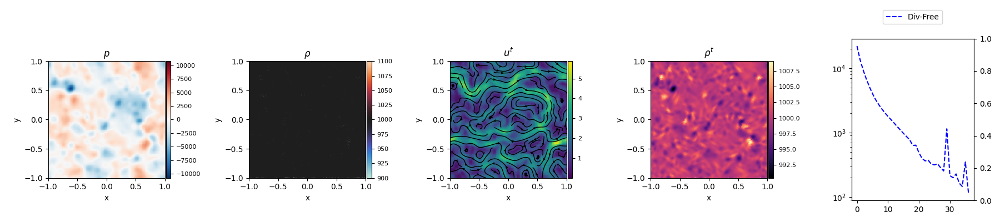

In [84]:
fig, axis = plt.subplots(1,5, figsize = (18,4), squeeze = False)

if 'pressure' not in solverState['fluid']:
    solverState['fluid']['pressure'] = torch.zeros_like(solverState['fluid']['densities'])
if 'pressureIncompressible' not in solverState['fluid']:
    solverState['fluid']['pressureIncompressible'] = torch.zeros_like(solverState['fluid']['densities'])

visualizationState = prepVisualizationState(solverState, config, grid = True)
# plotRegions(regions, axis[0,0])
# plotRegions(regions, axis[0,1])

rho, _ = callModule(solverState, computeDensity, config, 'fluid')

s = 1
div = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)


rhoPlot = visualizeParticleQuantity(fig, axis[0,1], config, visualizationState, quantity = 
                                      'densities',
                                      mapping = '.x', s = s, 
                          scaling = 'RdBu', gridVisualization=False, cmap = 'icefire', streamLines = False, operation = None, title = '$\\rho$', plotBoth = False, which = 'fluid', midPoint = 1000)
velPlot = visualizeParticleQuantity(fig, axis[0,2], config, visualizationState, quantity = 
                                      'velocities' ,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=True, cmap = 'viridis', streamLines = True, operation = None, title = '$u^t$', plotBoth = False, which = 'fluid', midPoint = 0)

accelPlot = visualizeParticleQuantity(fig, axis[0,3], config, visualizationState, quantity = 
                                     rho ,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'magma', streamLines = False, operation = None, title = '$\\rho^t$', plotBoth = False, which = 'fluid', midPoint = 0)


# pressure, iters, convergence, residuals, A, B, M_coo = projectVelocities(solverState['fluid'], solverState['fluid'], config, solverState['fluid']['neighborhood'])
# inc_pressure, iters_inc, convergence_inc, residuals_inc, A_inc, B_inc, M_coo_inc = solveIncompressible(solverState['fluid'], solverState['fluid'], config, solverState['fluid']['neighborhood'])
# iters_inc = len(convergence_inc)
# iters = len(convergence)

pressurePlot = visualizeParticleQuantity(fig, axis[0,0], config, visualizationState, quantity =
                                      'pressure',
                                      mapping = '.x', s = s, 
                          scaling = 'sym', gridVisualization=True, cmap = 'RdBu_r', title = '$p$', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)

# print(f'Convergence: {convergence} ')
convergence = frameStats['divergenceFreeConvergence']
# errors = frameStats['incompressibleConvergence']
# pressures = frameStats['incompressiblePressures']


# axis[0,4].semilogy([c[-1].detach().cpu().numpy() for c in convergence], label = 'Div-Free', ls = '--', color = 'blue')
# axis[0,4].semilogy([c[-1].detach().cpu().numpy() for c in convergence_inc_torch], label = 'Incompressible', ls = '--', color = 'orange')
axis[0,4].semilogy([c.detach().cpu().item() for c in convergence], label = 'Div-Free', ls = '--', color = 'blue')
# axis[0,4].semilogy(errors, label = 'Incompressible', ls = '--', color = 'orange')
axis[0,4].legend(loc='upper center', bbox_to_anchor=(0.5, 1.2), ncol = 2)


axResidual = axis[0,4].twinx()
# axResidual.semilogy([np.abs(c[0].detach().cpu()).max() for c in convergence], label = 'Pressure Div-Free', color = 'blue')
# axResidual.semilogy([c for c in pressures], label = 'Div-Free', color = 'blue')
# axResidual.semilogy([c for c in pressures], label = 'Pressure Incompressible', color = 'orange')
# axResidual.semilogy(pressures[-1], label = 'Pressure Incompressible', color = 'orange')

initialVelocities = initialState['fluid']['velocities'].clone()
currentVelocities = solverState['fluid']['velocities'].clone()

time = solverState['time']

areas = solverState['fluid']['areas']
densities = solverState['fluid']['densities']
rho0 = config['fluid']['rho0']

E_k0 =  (0.5 * areas * rho0 * torch.linalg.norm(initialVelocities, dim = -1)**2).sum().detach().cpu().numpy()

E_k = (0.5 * torch.sum(areas * densities * torch.linalg.norm(currentVelocities, dim = 1)**2)).sum().detach().cpu().numpy()

nu_total = np.log(E_k / E_k0) / (-4 *  time * k**2 )
Re = u_mag * 2 / nu_total


# fig.suptitle(f'''Iteration {0}, Time: {solverState["time"]:.4g},
# Divergence-Solve: CG Iterations: {iters}, residual: {convergence_torch[-1][-1]if len(convergence_torch) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressure"].mean():.6g}, mean Source: {B.mean():.6g}
# Incompressible-Solve: CG Iterations: {iters_inc}, residual: {convergence_inc_torch[-1][-1] if len(convergence_inc_torch) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressureIncompressible"].mean():.6g}, mean Source: {B_inc.mean():.6g}''')
# print(convergence)

# fig.suptitle(f'''Iteration {0}, Time: {solverState["time"]:.4g},
# Divergence-Solve: CG Iterations: {len(convergence)}, residual: {convergence[-1][-1]if len(convergence) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressure"].mean():.6g}, mean Source: {frameStats["divergenceFreeSourceTerm"].mean():.6g}
# Incompressible-Solve: CG Iterations: {len(errors)}, residual: {errors[-1] if len(errors) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressureIncompressible"].mean():.6g}, mean Source: {frameStats["incompressibleSourceTerm"].mean():.6g}
# E_k0 = {E_k0:.4g}, E_k = {E_k:.4g}, rel. diff = {(E_k - E_k0)/E_k0:.2%}, Re = {Re:.4g}''')

# fig.suptitle(f'''Iteration {0}, Time: {solverState["time"]:.4g},
# Divergence-Solve: CG Iterations: {len(convergence)}, residual: {convergence[-1]if len(convergence) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressure"].mean():.6g}, mean Source: {frameStats["divergenceFreeSourceTerm"].mean():.6g}
# Incompressible-Solve: CG Iterations: {len(errors)}, residual: {errors[-1] if len(errors) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressureIncompressible"].mean():.6g}, mean Source: {frameStats["incompressibleSourceTerm"].mean():.6g}
# E_k0 = {E_k0:.4g}, E_k = {E_k:.4g}, rel. diff = {(E_k - E_k0)/E_k0:.2%}, Re = {Re:.4g}''')
fig.tight_layout()

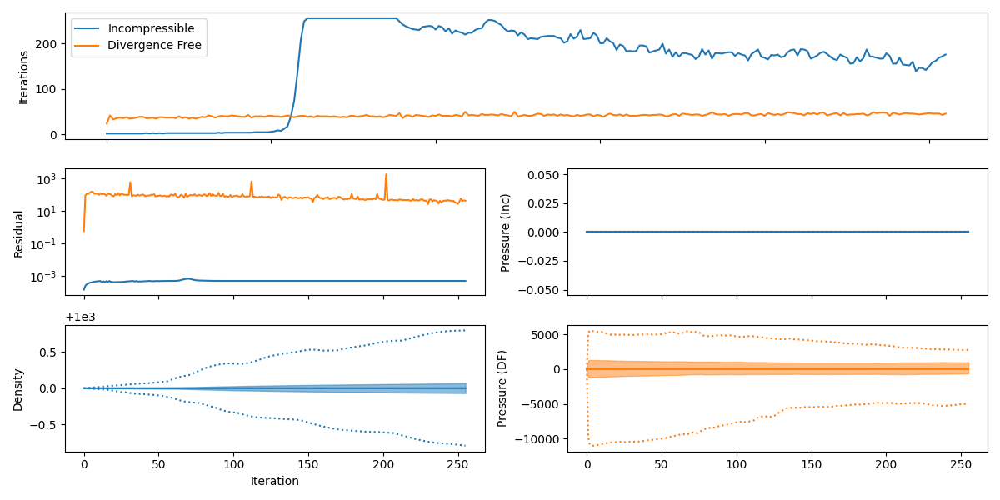

In [21]:
prop_cycle = plt.rcParams['axes.prop_cycle']
colors = prop_cycle.by_key()['color']

fig, axis = plt.subplot_mosaic('''AA
                               BC
                               DE''', figsize=(12, 6), sharex=True)

axis['A'].plot([s['incompressibleIters'] for s in stats], label='Incompressible')
axis['A'].plot([s['divergenceFreeIters'] for s in stats], label='Divergence Free')

axis['B'].plot([s['incompressibleConvergence'][-1] for s in stats], label='Incompressible Convergence')
axis['B'].plot([s['divergenceFreeConvergence'][-1].cpu() for s in stats], label='DF Convergence')
axis['B'].set_yscale('log')

# axis['C'].plot([s.cpu().abs().mean() for s in shiftAmount], label='Shift Amount')

axis['A'].legend()

# axis[0,0].set_title('Iterations')
# axis[1,0].set_title('Convergence')
# axis[2,0].set_title('Shift Amount')

axis['A'].set_ylabel('Iterations')
axis['B'].set_ylabel('Residual')
# axis['C'].set_ylabel('Shift Amount')
# axis[2,0].set_xlabel('Iteration')

axis['D'].plot([s['meanDensity'].cpu().item() for s in stats], label='Mean Density', color=colors[0])
axis['D'].fill_between(range(len(stats)), [s['q25Density'].cpu().item() for s in stats], [s['q75Density'].cpu().item() for s in stats], alpha=0.5, color=colors[0])
axis['D'].plot([s['maxDensity'].cpu().item() for s in stats], color=colors[0], ls = ':')
axis['D'].plot([s['minDensity'].cpu().item() for s in stats], color=colors[0], ls = ':')
axis['D'].set_ylabel('Density')
axis['D'].set_xlabel('Iteration')

axis['C'].plot([s['meanPressureIncompressible'].cpu().item() for s in stats], label='Incompressible Pressure', color=colors[0])
axis['C'].fill_between(range(len(stats)), [s['q25PressureIncompressible'].cpu().item() for s in stats], [s['q75PressureIncompressible'].cpu().item() for s in stats], alpha=0.5, color=colors[0])
axis['C'].plot([s['maxPressureIncompressible'].cpu().item() for s in stats], color=colors[0], ls = ':')
axis['C'].plot([s['minPressureIncompressible'].cpu().item() for s in stats], color=colors[0], ls = ':')
axis['C'].set_ylabel('Pressure (Inc)')

axis['E'].plot([s['meanPressure'].cpu().item() for s in stats], label='Pressure', color=colors[1])
axis['E'].fill_between(range(len(stats)), [s['q25Pressure'].cpu().item() for s in stats], [s['q75Pressure'].cpu().item() for s in stats], alpha=0.5, color=colors[1])
axis['E'].plot([s['maxPressure'].cpu().item() for s in stats], color=colors[1], ls = ':')
axis['E'].plot([s['minPressure'].cpu().item() for s in stats], color=colors[1], ls = ':')
axis['E'].set_ylabel('Pressure (DF)')

fig.tight_layout()

In [21]:
solverState['dt']

0.001

In [22]:
searchNeighbors(solverState, config)

# Advection Step
solverState['fluid']['densities'], _ = callModule(solverState, computeDensity, config, 'fluid')
solverState['fluid']['gravityAccel'] = computeGravity(solverState['fluid'], config)
solverState['fluid']['velocityDiffusion'], _ = callModule(solverState, computeViscosity, config, 'fluid')

# Divergence-Free Solver Preparation
solverState['fluid']['advection'] = solverState['fluid']['gravityAccel'] + solverState['fluid']['velocityDiffusion']
solverState['fluid']['initialVelocities'] = solverState['fluid']['velocities'].clone()
solverState['fluid']['advectionVelocities'] = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']
solverState['fluid']['velocityDivergence'] = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)
solverState['fluid']['advectionDivergence'] = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config, key='advectionVelocities')

v_star = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']
# Could also use actual density here
rho = torch.ones_like(solverState['fluid']['densities']) * config['fluid']['rho0']  # solverState['fluid']['densities'].view(-1,1)

# Solve Divergence-Free PPE
pressure_star, iters, residuals, convergence, B, accel_p_star, alpha = solveDivergenceFree_relaxedJacobi(solverState['fluid'], solverState['fluid'], config, solverState['dt'], neighborhood=solverState['fluid']['neighborhood'])


DF:  0 -> 0.6965193152427673, pressure mean: +3.9062e-03, pressure accel mean: +0.0000e+00 pressure: -9535220.0 12687185.0
DF:  1 -> 0.660237193107605, pressure mean: -1.7578e-02, pressure accel mean: +4.0296e+04 pressure: -8747501.0 13219954.0
DF:  2 -> 0.8072827458381653, pressure mean: +2.9297e-03, pressure accel mean: +2.5904e+04 pressure: -13044974.0 19487046.0
DF:  3 -> 1.0893232822418213, pressure mean: +1.1719e-02, pressure accel mean: +5.2291e+04 pressure: -13380077.0 18064660.0
DF:  4 -> 1.5255898237228394, pressure mean: -3.1250e-02, pressure accel mean: +4.3919e+04 pressure: -17407966.0 25502080.0
DF:  5 -> 2.169219493865967, pressure mean: -1.9531e-02, pressure accel mean: +8.0274e+04 pressure: -20484870.0 20523858.0
DF:  6 -> 3.122069835662842, pressure mean: -2.5391e-02, pressure accel mean: +8.6257e+04 pressure: -25397548.0 33229808.0
DF:  7 -> 4.522059440612793, pressure mean: +5.8594e-03, pressure accel mean: +1.4504e+05 pressure: -31277960.0 34053272.0
DF:  8 -> 6.58

In [23]:
solverState['fluid']['advectionDivergence'].max()

tensor(5.6445, device='cuda:0')

In [24]:
solverState['dt'] = 0.001
searchNeighbors(solverState, config)
solverState['fluid']['densities'], _ = callModule(solverState, computeDensity, config, 'fluid')
solverState['fluid']['gravityAccel'] = computeGravity(solverState['fluid'], config)
solverState['fluid']['velocityDiffusion'], _ = callModule(solverState, computeViscosity, config, 'fluid')

# Divergence-Free Solver Preparation
solverState['fluid']['advection'] = solverState['fluid']['gravityAccel'] + solverState['fluid']['velocityDiffusion']
solverState['fluid']['initialVelocities'] = solverState['fluid']['velocities'].clone()
solverState['fluid']['advectionVelocities'] = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']
solverState['fluid']['velocityDivergence'] = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)
solverState['fluid']['advectionDivergence'] = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config, key='advectionVelocities')

v_star = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']
# Could also use actual density here
rho = torch.ones_like(solverState['fluid']['densities']) * config['fluid']['rho0']  # solverState['fluid']['densities'].view(-1,1)

# Solve Divergence-Free PPE

pressure_star, iters, convergence, residuals, A, B, (A_sp, M_coo, rhs) = projectVelocities(solverState['fluid'], solverState['fluid'], config, solverState['fluid']['neighborhood'], solverState['dt'], returnSparseSystem=True)
iters = len(convergence)
print(f'Divergence-free convergence after {iters} iterations: {convergence[-1][1] if len(convergence) > 0 else 0}')
print(f'Pressure Stats: {pressure_star.max()} | {pressure_star.min()} | {pressure_star.mean()}')

gradp_star = sphOperationStates(solverState['fluid'], solverState['fluid'], (pressure_star, pressure_star), operation='gradient', gradientMode='summation', neighborhood=solverState['fluid']['neighborhood'])
accel_p_star = -gradp_star / rho.view(-1, 1)
print(f'Pressure Acceleration: {accel_p_star.max()} | {accel_p_star.min()} | {accel_p_star.mean()}')

Divergence-free convergence after 68 iterations: 128.22552490234375
Pressure Stats: 6298.13330078125 | -11604.1240234375 | -1.52587890625e-05
Pressure Acceleration: 102.91073608398438 | -117.56504821777344 | 0.00019657611846923828


In [25]:
B

tensor([-157.6619, -155.6322, -794.4385,  ...,  268.4931, 1114.0935,
        1263.3298], device='cuda:0')

In [26]:
config['shifting']['scheme'] = 'IPS'
config['shifting']['maxIterations'] = 1
config['shifting']['summationDensity'] = True
config['shifting']['threshold'] = 0.1

In [27]:
# newState = copy.deepcopy(solverState)
# newState['fluid']['areas'] *= config['particle']['dx']
# newState['fluid']['masses'] *= config['particle']['dx']


p_starstar, iters_inc, errors, pressures, sourceTerm, pressureAccel, alpha = solveDivergenceFree_relaxedJacobi(solverState['fluid'], solverState['fluid'], config, solverState['dt'], neighborhood=solverState['fluid']['neighborhood'])

DF:  0 -> 0.6965193152427673, pressure mean: +3.9062e-03, pressure accel mean: +0.0000e+00 pressure: -9535218.0 12687185.0
DF:  1 -> 0.660237193107605, pressure mean: -1.7578e-02, pressure accel mean: +4.0296e+04 pressure: -8747497.0 13219958.0
DF:  2 -> 0.8072828054428101, pressure mean: -7.8125e-03, pressure accel mean: +2.5904e+04 pressure: -13044983.0 19487046.0
DF:  3 -> 1.0893231630325317, pressure mean: +7.8125e-03, pressure accel mean: +5.2291e+04 pressure: -13380076.0 18064670.0
DF:  4 -> 1.5255898237228394, pressure mean: -4.6875e-02, pressure accel mean: +4.3919e+04 pressure: -17407944.0 25502072.0
DF:  5 -> 2.1692192554473877, pressure mean: -1.5625e-02, pressure accel mean: +8.0274e+04 pressure: -20484872.0 20523872.0
DF:  6 -> 3.122070074081421, pressure mean: -1.5625e-02, pressure accel mean: +8.6257e+04 pressure: -25397554.0 33229780.0
DF:  7 -> 4.522059917449951, pressure mean: -1.3672e-02, pressure accel mean: +1.4504e+05 pressure: -31277962.0 34053292.0
DF:  8 -> 6.5

NameError: name 'pressure_star' is not defined

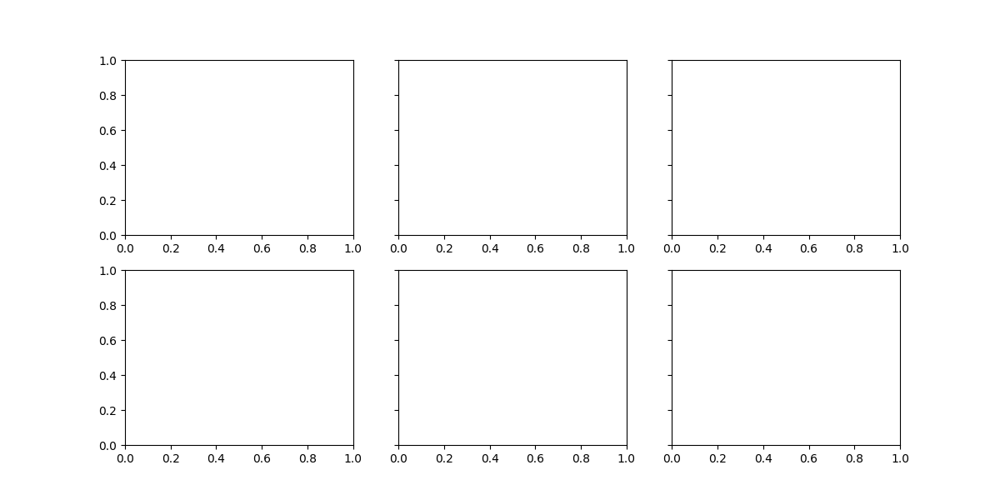

In [23]:


fig, axis = plt.subplots(2,3, figsize = (12,6), squeeze = False, sharey = True)


visualizationState = prepVisualizationState(newState, config, grid = True)
# plotRegions(regions, axis[0,0])
# plotRegions(regions, axis[0,1])

s = 1
# div = computeDivergence(incompressibleState['fluid'], incompressibleState['fluid'], incompressibleState['fluid']['neighborhood'], config)


pressurePlot = visualizeParticleQuantity(fig, axis[0,0], config, visualizationState, quantity =
                                      pressure_star - pressure_star.mean(),
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'RdBu_r', title = 'pressure (PPE)', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
rhoPlot = visualizeParticleQuantity(fig, axis[0,1], config, visualizationState, quantity = 
                                      p_starstar - p_starstar.mean(),
                                      mapping = '.y', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'RdBu_r', streamLines = False, operation = None, title = 'pressure (DFSPH)', plotBoth = False, which = 'fluid', midPoint = 0)
rhoPlot = visualizeParticleQuantity(fig, axis[0,2], config, visualizationState, quantity = 
                                      (p_starstar - p_starstar.mean()) - (pressure_star - pressure_star.mean()),
                                      mapping = '.y', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'RdBu_r', streamLines = False, operation = None, title = 'pressure (DFSPH)', plotBoth = False, which = 'fluid', midPoint = 0)


velPlot = visualizeParticleQuantity(fig, axis[1,0], config, visualizationState, quantity = 
                                      # (initialDensity - config['fluid']['rho0']) / config['fluid']['rho0'],
                                    #   (incompressibleState['fluid']['densities'] - config['fluid']['rho0']).abs() / config['fluid']['rho0'],
                                    B,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'viridis', streamLines = False, operation = None, title = 'source (PPE)', plotBoth = False, which = 'fluid', midPoint = 0)


velPlot = visualizeParticleQuantity(fig, axis[1,1], config, visualizationState, quantity = 
                                      (solverState['fluid']['densities'] - config['fluid']['rho0']),#.abs() / config['fluid']['rho0'],
                                      # sourceTerm * config['fluid']['rho0'],
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'viridis', streamLines = False, operation = None, title = 'source (DFSPH)', plotBoth = False, which = 'fluid', midPoint = 0)

velPlot = visualizeParticleQuantity(fig, axis[1,2], config, visualizationState, quantity =
                                      'velocities',
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'viridis', streamLines = False, operation = None, title = 'source (DFSPH)', plotBoth = False, which = 'fluid', midPoint = 0)
                                    


fig.tight_layout()

In [153]:
config['particle']['dx'] * 2

tensor(0.0312, device='cuda:0')

In [154]:
solverState['fluid']['supports'] / config['kernel']['kernelScale']

tensor([0.0312, 0.0312, 0.0312,  ..., 0.0312, 0.0312, 0.0312], device='cuda:0')

In [155]:
p_starstar / pressure_star

tensor([ -577221.8750, -2584675.7500,   912893.8125,  ...,
          225278.2812,   191363.0469,   125807.1406], device='cuda:0')

In [156]:
alpha# * solverState['dt'] * config['fluid']['rho0']**4

tensor([-2.9644e-07, -2.9680e-07, -2.9407e-07,  ..., -2.9550e-07,
        -2.9533e-07, -2.9650e-07], device='cuda:0')

In [157]:
A[0][A[1][0] == A[1][1]]

tensor([-6.6002, -6.5987, -6.6069,  ..., -6.6030, -6.6035, -6.5990],
       device='cuda:0')

In [158]:
alpha / A[0][A[1][0] == A[1][1]]

tensor([4.4915e-08, 4.4979e-08, 4.4509e-08,  ..., 4.4753e-08, 4.4722e-08,
        4.4930e-08], device='cuda:0')

In [159]:
print(A[1][0], A[1][1], A[0][A[1][0] == 0])

tensor([    0,     0,     0,  ..., 16383, 16383, 16383], device='cuda:0') tensor([  252,   381, 16381,  ..., 16131, 16258, 16259], device='cuda:0') tensor([ 1.4777e-06,  7.7471e-05,  1.0366e-04,  5.1015e-08,  1.8289e-05,
         4.0469e-03,  1.0107e-02,  1.8424e-02,  4.1817e-04, -6.6002e+00,
         7.2445e-01,  5.4518e-03,  1.5180e-01,  7.1770e-01,  6.7272e-01,
         2.6053e-01,  1.4812e-02,  2.0615e-01,  5.6335e-01,  2.9446e-02,
         1.2229e-01,  1.1284e-01,  1.8413e-01,  1.3830e-03,  3.4607e-02,
         6.1950e-01,  6.6072e-01,  3.2523e-02,  2.6137e-01,  1.5603e-01,
         3.8926e-02,  1.8650e-04,  1.0018e-02,  1.9595e-03,  1.8287e-04,
         5.3528e-03,  1.4378e-06,  1.0955e-11,  4.5026e-05,  9.6921e-06,
         8.1931e-03,  2.3451e-01,  1.0554e-01,  1.3713e-02,  4.0360e-05,
         3.2379e-02,  5.3327e-04,  1.5613e-01,  3.5089e-02,  6.9432e-04,
         6.2876e-11,  3.1813e-01,  4.0505e-02,  4.7010e-03,  6.6853e-07,
         2.7562e-02,  3.7493e-04,  3.1725e-04,  9

In [160]:
config['fluid']['rho0'] * solverState['dt']

1.0

In [161]:
config['shifting']

{'scheme': 'IPS',
 'threshold': 0.1,
 'maxIterations': 1,
 'freeSurface': False,
 'R': 0.25,
 'n': 4,
 'CFL': 1.5,
 'computeMach': True,
 'solver': 'BiCGStab_wJacobi',
 'normalScheme': 'lambda',
 'projectionScheme': 'mat',
 'surfaceScaling': 0.1,
 'summationDensity': True,
 'useExtendedMask': False,
 'initialization': 'zero',
 'maxSolveIter': 64,
 'surfaceDetection': 'Barcasco',
 'active': True}

In [162]:
config['shifting']['summationDensity'] = False
config['shifting']['threshold'] = 1

In [163]:
incompressibleState = copy.deepcopy(initialState)
incompressibleState['dt'] = 0.001
incompressibleState['fluid']['positions'] += 0.01 * torch.randn_like(incompressibleState['fluid']['positions'])

searchNeighbors(incompressibleState, config)
incompressibleState['fluid']['densities'], _ =  callModule(incompressibleState, computeDensity, config, 'fluid')
initialDensity = incompressibleState['fluid']['densities'].clone()
incompressibleState['fluid']['advection'] = torch.zeros_like(incompressibleState['fluid']['velocities'])
incompressibleState['fluid']['velocities'] = torch.zeros_like(incompressibleState['fluid']['velocities'])

for i in tqdm(range(16)):
    searchNeighbors(incompressibleState, config)
    # incompressibleState['fluid']['densities'] = config['fluid']['rho0'] * torch.ones_like(incompressibleState['fluid']['densities'])
    incompressibleState['fluid']['densities'], _ =  callModule(incompressibleState, computeDensity, config, 'fluid')
    dx, _ = solveShifting(incompressibleState, config)

    incompressibleState['fluid']['positions'] += dx * 0.5
    searchNeighbors(incompressibleState, config)

    incompressibleState['fluid']['densities'], _ =  callModule(incompressibleState, computeDensity, config, 'fluid')
    rho = incompressibleState['fluid']['densities']

    p_starstar, iters_inc, errors, pressures, sourceTerm, pressureAccel = solveIncompressible_relaxedJacobi(incompressibleState['fluid'], incompressibleState['fluid'], config, incompressibleState['dt'], neighborhood=incompressibleState['fluid']['neighborhood'])

    # gradp_starstar = sphOperationStates(incompressibleState['fluid'], incompressibleState['fluid'], (p_starstar, p_starstar), operation='gradient', gradientMode='symmetric', neighborhood= incompressibleState['fluid']['neighborhood']) 
    # particleShift = -incompressibleState['dt'] ** 2  * gradp_starstar / config['fluid']['rho0'] # rho.view(-1, 1)
    # particleShift = -incompressibleState['dt'] ** 2  * gradp_starstar / rho.view(-1, 1)
    particleShift = incompressibleState['dt'] **2 * pressureAccel

    incompressibleState['fluid']['pressureIncompressible'] = p_starstar #* 0.
    incompressibleState['fluid']['positions'] += particleShift
    # dx, states = solveShifting(incompressibleState, config)
    # incompressibleState['fluid']['positions'] += dx
    incompressibleState['fluid']['velocities'][:,0] =  u_mag * torch.cos(k * incompressibleState['fluid']['positions'][:,0]) * torch.sin(k * incompressibleState['fluid']['positions'][:,1])
    incompressibleState['fluid']['velocities'][:,1] = -u_mag * torch.sin(k * incompressibleState['fluid']['positions'][:,0]) * torch.cos(k * incompressibleState['fluid']['positions'][:,1])
    incompressibleState['fluid']['velocities'] = torch.zeros_like(incompressibleState['fluid']['velocities'])

    print(f'Error: {errors[0]} -> {errors[-1]}' , f'Pressure: {pressures[-1]}', f'Iterations: {iters_inc}, Density {(rho - config["fluid"]["rho0"]).abs().mean() / config["fluid"]["rho0"]}')




searchNeighbors(incompressibleState, config)
incompressibleState['fluid']['densities'], _ =  callModule(incompressibleState, computeDensity, config, 'fluid')

print(pressures)


  0%|          | 0/16 [00:00<?, ?it/s]

Initial Density: 377.089599609375 | -280.4896240234375 | 71.53137969970703
Predicted Density: 377.089599609375 | -280.4896240234375 | 71.53137969970703
Source Term: 0.2804896831512451 | -0.37708961963653564 | 0.07153137028217316
Advection Divergence: 0.0 | 0.0 | 0.0
	PS:  0 -> +7.1531e-02, pressure mean: +1.8881e+04, pressure accel mean: +0.0000e+00, pressure min: -123031.3828125 max: 341383.0
	PS:  1 -> +3.1256e-02, pressure mean: +2.6089e+04, pressure accel mean: +1.5759e+03, pressure min: -197153.796875 max: 419845.71875
	PS:  2 -> +2.2373e-02, pressure mean: +3.0068e+04, pressure accel mean: +1.9576e+03, pressure min: -258639.796875 max: 478049.59375
	PS:  3 -> +1.8428e-02, pressure mean: +3.2487e+04, pressure accel mean: +2.1409e+03, pressure min: -303236.3125 max: 524307.5625
	PS:  4 -> +1.6180e-02, pressure mean: +3.3987e+04, pressure accel mean: +2.2519e+03, pressure min: -335349.59375 max: 564856.4375
	PS:  5 -> +1.4700e-02, pressure mean: +3.4882e+04, pressure accel mean: +2.

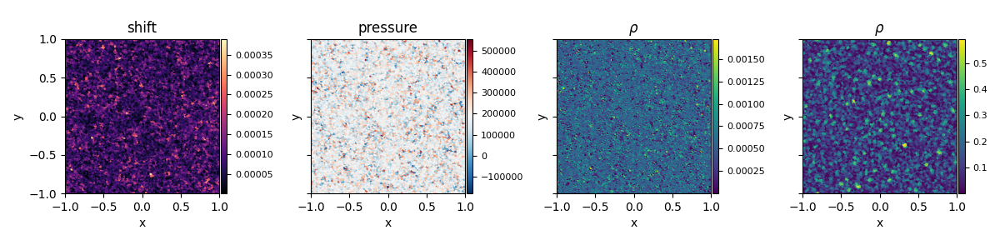

In [164]:
fig, axis = plt.subplots(1,4, figsize = (12,3), squeeze = False, sharey = True)


visualizationState = prepVisualizationState(incompressibleState, config, grid = True)
# plotRegions(regions, axis[0,0])
# plotRegions(regions, axis[0,1])

s = 1
div = computeDivergence(incompressibleState['fluid'], incompressibleState['fluid'], incompressibleState['fluid']['neighborhood'], config)


pressurePlot = visualizeParticleQuantity(fig, axis[0,0], config, visualizationState, quantity =
                                      dx,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'magma', title = 'shift', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
rhoPlot = visualizeParticleQuantity(fig, axis[0,1], config, visualizationState, quantity = 
                                      p_starstar,
                                      mapping = '.y', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'RdBu_r', streamLines = False, operation = None, title = 'pressure', plotBoth = False, which = 'fluid', midPoint = 0)
velPlot = visualizeParticleQuantity(fig, axis[0,2], config, visualizationState, quantity = 
                                      # (initialDensity - config['fluid']['rho0']) / config['fluid']['rho0'],
                                      (incompressibleState['fluid']['densities'] - config['fluid']['rho0']).abs() / config['fluid']['rho0'],
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'viridis', streamLines = False, operation = None, title = '$\\rho$', plotBoth = False, which = 'fluid', midPoint = 0)
velPlot = visualizeParticleQuantity(fig, axis[0,3], config, visualizationState, quantity = 
                                      (initialDensity - config['fluid']['rho0']).abs() / config['fluid']['rho0'],
                                      # sourceTerm,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'viridis', streamLines = False, operation = None, title = '$\\rho$', plotBoth = False, which = 'fluid', midPoint = 0)



fig.tight_layout()

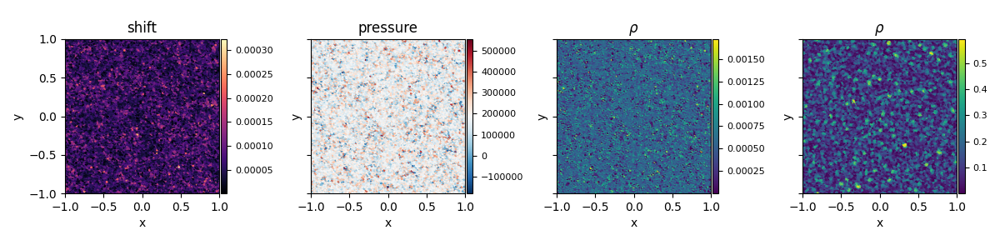

In [165]:
fig, axis = plt.subplots(1,4, figsize = (12,3), squeeze = False, sharey = True)


visualizationState = prepVisualizationState(incompressibleState, config, grid = True)
# plotRegions(regions, axis[0,0])
# plotRegions(regions, axis[0,1])

s = 1
div = computeDivergence(incompressibleState['fluid'], incompressibleState['fluid'], incompressibleState['fluid']['neighborhood'], config)


pressurePlot = visualizeParticleQuantity(fig, axis[0,0], config, visualizationState, quantity =
                                      particleShift,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'magma', title = 'shift', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
rhoPlot = visualizeParticleQuantity(fig, axis[0,1], config, visualizationState, quantity = 
                                      p_starstar,
                                      mapping = '.y', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'RdBu_r', streamLines = False, operation = None, title = 'pressure', plotBoth = False, which = 'fluid', midPoint = 0)
velPlot = visualizeParticleQuantity(fig, axis[0,2], config, visualizationState, quantity = 
                                      # (initialDensity - config['fluid']['rho0']) / config['fluid']['rho0'],
                                      (incompressibleState['fluid']['densities'] - config['fluid']['rho0']).abs() / config['fluid']['rho0'],
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'viridis', streamLines = False, operation = None, title = '$\\rho$', plotBoth = False, which = 'fluid', midPoint = 0)
velPlot = visualizeParticleQuantity(fig, axis[0,3], config, visualizationState, quantity = 
                                      (initialDensity - config['fluid']['rho0']).abs() / config['fluid']['rho0'],
                                      # sourceTerm,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'viridis', streamLines = False, operation = None, title = '$\\rho$', plotBoth = False, which = 'fluid', midPoint = 0)



fig.tight_layout()

In [167]:

# def simulationStep(solverState, config):
#     searchNeighbors(solverState, config)

#     print(f'Start of simulation step')

#     # Advection Step
#     solverState['fluid']['densities'], _ = callModule(solverState, computeDensity, config, 'fluid')
#     solverState['fluid']['gravityAccel'] = computeGravity(solverState['fluid'], config)
#     solverState['fluid']['velocityDiffusion'], _ = callModule(solverState, computeViscosity, config, 'fluid')

#     # Divergence-Free Solver Preparation
#     solverState['fluid']['advection'] = solverState['fluid']['gravityAccel'] + solverState['fluid']['velocityDiffusion']
#     # solverState['fluid']['initialVelocities'] = solverState['fluid']['velocities'].clone()
#     # solverState['fluid']['advectionVelocities'] = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']
#     # solverState['fluid']['velocityDivergence'] = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)
#     # solverState['fluid']['advectionDivergence'] = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config, key='advectionVelocities')

#     print(f'Density: {solverState["fluid"]["densities"].max()} | {solverState["fluid"]["densities"].min()} | {solverState["fluid"]["densities"].mean()}')
#     print(f'Gravity: {solverState["fluid"]["gravityAccel"].max()} | {solverState["fluid"]["gravityAccel"].min()} | {solverState["fluid"]["gravityAccel"].mean()}')
#     print(f'Viscosity: {solverState["fluid"]["velocityDiffusion"].max()} | {solverState["fluid"]["velocityDiffusion"].min()} | {solverState["fluid"]["velocityDiffusion"].mean()}')
#     print(f'Advection: {torch.linalg.norm(solverState["fluid"]["advection"], dim = -1).max()} | {torch.linalg.norm(solverState["fluid"]["advection"], dim = -1).min()} | {torch.linalg.norm(solverState["fluid"]["advection"], dim = -1).mean()}')
    
#     v_star = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']
#     # Could also use actual density here
#     # rho = torch.ones_like(solverState['fluid']['densities']) * config['fluid']['rho0']  # solverState['fluid']['densities'].view(-1,1)

#     # Solve Divergence-Free PPE
#     pressure_star, iters, residuals, convergence, B, accel_p_star, alpha = solveDivergenceFree_relaxedJacobi(solverState['fluid'], solverState['fluid'], config, solverState['dt'], neighborhood=solverState['fluid']['neighborhood'])



#     # pressure_star, iters, convergence, residuals, A, B, (A_sp, M_coo, rhs) = projectVelocities(solverState['fluid'], solverState['fluid'], config, solverState['fluid']['neighborhood'], solverState['dt'], returnSparseSystem=True)
#     # iters = len(convergence)
#     # print(f'Divergence-free convergence after {iters} iterations: {convergence[-1][1] if len(convergence) > 0 else 0}')
#     # print(f'Pressure Stats: {pressure_star.max()} | {pressure_star.min()} | {pressure_star.mean()}')

#     # gradp_star = sphOperationStates(solverState['fluid'], solverState['fluid'], (pressure_star, pressure_star), operation='gradient', gradientMode='summation', neighborhood=solverState['fluid']['neighborhood'])
#     # accel_p_star = -gradp_star / rho.view(-1, 1)
#     # print(f'Pressure Acceleration: {accel_p_star.max()} | {accel_p_star.min()} | {accel_p_star.mean()}')
#     solverState['fluid']['pressure'] = pressure_star
#     solverState['fluid']['pressureAcceleration'] = -accel_p_star

#     print(f'Pressure Stats: {pressure_star.max()} | {pressure_star.min()} | {pressure_star.mean()}')
#     print(f'Pressure Acceleration {torch.linalg.norm(accel_p_star, dim = -1).max()} | {torch.linalg.norm(accel_p_star, dim = -1).min()} | {torch.linalg.norm(accel_p_star, dim = -1).mean()}')
          
#     ## Check for proper convergence behavior
#     # initialDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (solverState['fluid']['velocities'], solverState['fluid']['velocities']), operation='divergenceConsistent', neighborhood=solverState['fluid']['neighborhood'], gradientMode='difference')
#     # advectionDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (v_star, v_star), operation='divergenceConsistent', neighborhood=solverState['fluid']['neighborhood'])

#     # print(f'Initial Divergence : {initialDivergence.min()} | {initialDivergence.max()} | {initialDivergence.mean()}')
#     # print(f'Divergence after DF: {advectionDivergence.min()} | {advectionDivergence.max()} | {advectionDivergence.mean()}')
#     v_prime = v_star + accel_p_star * solverState['dt']  # / 10**3 

#     # finalVelocities = v_prime
#     # finalPositions = solverState['fluid']['positions'] + v_prime * solverState['dt']

#     # solverState['fluid']['divergenceFreeVelocities'] = v_prime
#     # accel_p_star = accel_p_star * 0

#     ## Prepare incompressible PPE
#     # v_prime = v_star + accel_p_star * solverState['dt']  # / 10**3 
#     # solvedDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (v_prime, v_prime), operation='divergenceConsistent', neighborhood=solverState['fluid']['neighborhood'])

#     solverState['fluid']['advection'] += accel_p_star# * solverState['dt']

#     ## Solve Incompressible PPE
#     # for i in range(1):
#         # searchNeighbors(solverState, config)
#         # solverState['fluid']['densities'], _ = callModule(solverState, computeDensity, config, 'fluid')
#         # if i > 0:
#         #     solverState['fluid']['advection'][:,0] = 0
#         #     solverState['fluid']['advection'][:,1] = 0
#         #     v_prime = finalVelocities

#     # solverState['fluid']['positions'] = solverState['fluid']['positions'] + solverState['dt'] * v_prime
#     # solverState['fluid']['velocities'] = v_prime
#     # solverState['fluid']['advection'] = torch.zeros_like(solverState['fluid']['velocities'])
#     # searchNeighbors(solverState, config)

#     p_starstar, iters_inc, errors, pressures, sourceTerm, pressureAccel = solveIncompressible_relaxedJacobi(solverState['fluid'], solverState['fluid'], config, solverState['dt'], neighborhood=solverState['fluid']['neighborhood'])
#     # print(f'Pressure Stats: {p_starstar.max()} | {p_starstar.min()} | {p_starstar.mean()}')
#     solverState['fluid']['pressureIncompressible'] = p_starstar
    
#     print(f'Pressure Stats: {p_starstar.max()} | {p_starstar.min()} | {p_starstar.mean()}')
#     print(f'Pressure Acceleration {torch.linalg.norm(pressureAccel, dim = -1).max()} | {torch.linalg.norm(pressureAccel, dim = -1).min()} | {torch.linalg.norm(pressureAccel, dim = -1).mean()}')

#     # gradp_starstar = sphOperationStates(solverState['fluid'], solverState['fluid'], (p_starstar, p_starstar), operation='gradient', gradientMode='symmetric', neighborhood= solverState['fluid']['neighborhood']) 
#     # particleShift = -solverState['dt'] ** 2  * gradp_starstar / rho.view(-1, 1)
#     particleShift = solverState['dt'] **2 * pressureAccel
#     gradV = -sphOperationStates(solverState['fluid'], solverState['fluid'], (v_prime, v_prime), operation='gradient', gradientMode='difference', neighborhood=solverState['fluid']['neighborhood'])
#     # print(f'particleShift: {particleShift.max()} | {particleShift.min()} | {particleShift.mean()}')

#     # Project velocities
#     projectedVelocity = v_prime - torch.bmm(gradV.mT, particleShift.unsqueeze(-1)).squeeze(-1)
#     finalVelocities = projectedVelocity

#     print(f'Projected Velocity: {projectedVelocity.max()} | {projectedVelocity.min()} | {projectedVelocity.mean()}')
#     # finalVelocities = v_prime
#     # if i == 0:
    
#     finalPositions = solverState['fluid']['positions'] + v_prime * solverState['dt'] + particleShift
#     # finalPositions = solverState['fluid']['positions'] + particleShift
#     # else:
#         # finalPositions += particleShift
#     # solverState['fluid']['particleShift'] = particleShift
#     # solverState['fluid']['projectedVelocities'] = projectedVelocity
#     # print(solverState['dt'])
#     solverState['fluid']['velocities'] = finalVelocities
#     # solverState['fluid']['positions'] += finalVelocities * solverState['dt']#+ a_pi* solverState['dt']**2
#     solverState['fluid']['positions'] = finalPositions

#     finalDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (finalVelocities, finalVelocities), neighborhood=solverState['fluid']['neighborhood'], operation='divergence')

#     frameStats = {
#         # 'initialDivergence': initialDivergence,
#         # 'advectionDivergence': advectionDivergence,
#         # 'solvedDivergence': solvedDivergence,
#         'finalDivergence': finalDivergence,

#         'divergenceFreeIters': iters,
#         'divergenceFreeConvgerence': residuals,
#         'divergenceFreeResiduals': residuals,
#         'divergenceFreePressure': pressure_star,
#         'divergenceFreeSourceTerm': B,
        
#         'incompressibleIters': iters_inc,
#         'incompressibleConvergence': errors,
#         'incompressiblePressures': pressures,
#         'incompressibleSourceTerm': sourceTerm
#     }

#     return solverState, frameStats

In [64]:
config['diffusion']

{'velocityScheme': 'deltaSPH_inviscid',
 'delta': 0.1,
 'densityScheme': 'deltaSPH',
 'nu': 0.01,
 'alpha': 0.05,
 'beta': 0.0,
 'pi-switch': False,
 'artificial-constant': 0.02,
 'eps': 1e-06,
 'nu_sph': 0.002,
 'Re': 2000.0}

In [193]:
initialState['dt']

tensor(0.0005, device='cuda:0')

In [137]:
solverState = copy.deepcopy(initialState)
solverState['dt'] = 0.001
for i in range(16):
    solverState, frameStats = simulationStep(solverState, config)
    dx, _ = solveShifting(solverState, config)
    solverState['fluid']['positions'] += 0.5 *  dx
# solverState, frameStats = simulationStep(solverState, config)
# solverState, frameStats = simulationStep(solverState, config)

  0	Div:  22 |    0.5, PS:   2 | 9.8845e-05, rho: -0.3602 | 0.0009766 | 0.3832
  0	Div:  47 |   75.4, PS:   2 | 1.3294e-04, rho: -0.5361 | 0.003723 | 0.4921
  0	Div:  41 |  105.7, PS:   2 | 1.3772e-04, rho: -0.5939 | 0.007935 | 0.4741
  0	Div:  41 |  116.8, PS:   2 | 1.3850e-04, rho: -0.6118 | 0.01343 | 0.4504
  0	Div:  39 |  117.6, PS:   2 | 1.4020e-04, rho: -0.6199 | 0.0199 | 0.4406
  0	Div:  39 |  117.9, PS:   2 | 1.4278e-04, rho: -0.619 | 0.0271 | 0.4415
  0	Div:  38 |  124.5, PS:   2 | 1.4563e-04, rho: -0.6181 | 0.0351 | 0.455
  0	Div:  39 |  116.0, PS:   2 | 1.4833e-04, rho: -0.624 | 0.0437 | 0.4753
  0	Div:  38 |  120.2, PS:   2 | 1.5079e-04, rho: -0.6299 | 0.05298 | 0.505
  0	Div:  38 |  116.3, PS:   2 | 1.5305e-04, rho: -0.6345 | 0.06323 | 0.5414
  0	Div:  37 |  114.0, PS:   2 | 1.5524e-04, rho: -0.6387 | 0.07434 | 0.5789
  0	Div:  37 |  102.4, PS:   2 | 1.5743e-04, rho: -0.6423 | 0.08649 | 0.6153
  0	Div:  41 |  108.5, PS:   2 | 1.5960e-04, rho: -0.6435 | 0.09979 | 0.6484
  0

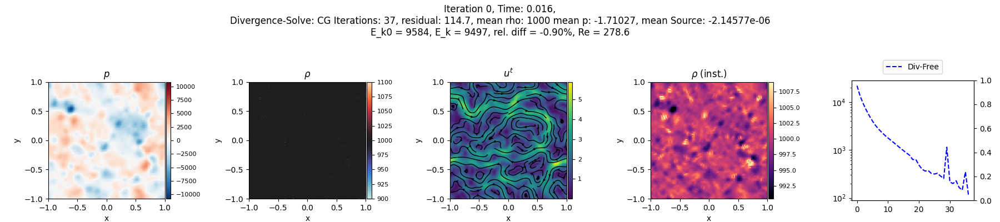

In [85]:
fig, axis = plt.subplots(1,5, figsize = (18,4), squeeze = False)

if 'pressure' not in solverState['fluid']:
    solverState['fluid']['pressure'] = torch.zeros_like(solverState['fluid']['densities'])
if 'pressureIncompressible' not in solverState['fluid']:
    solverState['fluid']['pressureIncompressible'] = torch.zeros_like(solverState['fluid']['densities'])

visualizationState = prepVisualizationState(solverState, config, grid = True)
# plotRegions(regions, axis[0,0])
# plotRegions(regions, axis[0,1])

rho, _ = callModule(solverState, computeDensity, config, 'fluid')

s = 1
div = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)


rhoPlot = visualizeParticleQuantity(fig, axis[0,1], config, visualizationState, quantity = 
                                      'densities',
                                      mapping = '.x', s = s, 
                          scaling = 'RdBu', gridVisualization=False, cmap = 'icefire', streamLines = False, operation = None, title = '$\\rho$', plotBoth = False, which = 'fluid', midPoint = 1000)
velPlot = visualizeParticleQuantity(fig, axis[0,2], config, visualizationState, quantity = 
                                      'velocities' ,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=True, cmap = 'viridis', streamLines = True, operation = None, title = '$u^t$', plotBoth = False, which = 'fluid', midPoint = 0)

accelPlot = visualizeParticleQuantity(fig, axis[0,3], config, visualizationState, quantity = 
                                     rho,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=True, cmap = 'magma', streamLines = False, operation = None, title = '$\\rho$ (inst.)', plotBoth = False, which = 'fluid', midPoint = 0)


# pressure, iters, convergence, residuals, A, B, M_coo = projectVelocities(solverState['fluid'], solverState['fluid'], config, solverState['fluid']['neighborhood'])
# inc_pressure, iters_inc, convergence_inc, residuals_inc, A_inc, B_inc, M_coo_inc = solveIncompressible(solverState['fluid'], solverState['fluid'], config, solverState['fluid']['neighborhood'])
# iters_inc = len(convergence_inc)
# iters = len(convergence)

pressurePlot = visualizeParticleQuantity(fig, axis[0,0], config, visualizationState, quantity =
                                      'pressure',
                                      mapping = '.x', s = s, 
                          scaling = 'sym', gridVisualization=True, cmap = 'RdBu_r', title = '$p$', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)

# print(f'Convergence: {convergence} ')
convergence = frameStats['divergenceFreeConvergence']
# errors = frameStats['incompressibleConvergence']
# pressures = frameStats['incompressiblePressures']


# axis[0,4].semilogy([c[-1].detach().cpu().numpy() for c in convergence], label = 'Div-Free', ls = '--', color = 'blue')
# axis[0,4].semilogy([c[-1].detach().cpu().numpy() for c in convergence_inc_torch], label = 'Incompressible', ls = '--', color = 'orange')
axis[0,4].semilogy([c.detach().cpu().item() for c in convergence], label = 'Div-Free', ls = '--', color = 'blue')
# axis[0,4].semilogy(errors, label = 'Incompressible', ls = '--', color = 'orange')
axis[0,4].legend(loc='upper center', bbox_to_anchor=(0.5, 1.2), ncol = 2)


axResidual = axis[0,4].twinx()
# axResidual.semilogy([np.abs(c[0].detach().cpu()).max() for c in convergence], label = 'Pressure Div-Free', color = 'blue')
# axResidual.semilogy([c for c in pressures], label = 'Div-Free', color = 'blue')
# axResidual.semilogy([c for c in pressures], label = 'Pressure Incompressible', color = 'orange')
# axResidual.semilogy(pressures[-1], label = 'Pressure Incompressible', color = 'orange')

initialVelocities = initialState['fluid']['velocities'].clone()
currentVelocities = solverState['fluid']['velocities'].clone()

time = solverState['time']

areas = solverState['fluid']['areas']
densities = solverState['fluid']['densities']
rho0 = config['fluid']['rho0']

E_k0 =  (0.5 * areas * rho0 * torch.linalg.norm(initialVelocities, dim = -1)**2).sum().detach().cpu().numpy()

E_k = (0.5 * torch.sum(areas * densities * torch.linalg.norm(currentVelocities, dim = 1)**2)).sum().detach().cpu().numpy()

nu_total = np.log(E_k / E_k0) / (-4 *  time * k**2 )
Re = u_mag * 2 / nu_total


# fig.suptitle(f'''Iteration {0}, Time: {solverState["time"]:.4g},
# Divergence-Solve: CG Iterations: {iters}, residual: {convergence_torch[-1][-1]if len(convergence_torch) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressure"].mean():.6g}, mean Source: {B.mean():.6g}
# Incompressible-Solve: CG Iterations: {iters_inc}, residual: {convergence_inc_torch[-1][-1] if len(convergence_inc_torch) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressureIncompressible"].mean():.6g}, mean Source: {B_inc.mean():.6g}''')
# print(convergence)

# fig.suptitle(f'''Iteration {0}, Time: {solverState["time"]:.4g},
# Divergence-Solve: CG Iterations: {len(convergence)}, residual: {convergence[-1][-1]if len(convergence) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressure"].mean():.6g}, mean Source: {frameStats["divergenceFreeSourceTerm"].mean():.6g}
# Incompressible-Solve: CG Iterations: {len(errors)}, residual: {errors[-1] if len(errors) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressureIncompressible"].mean():.6g}, mean Source: {frameStats["incompressibleSourceTerm"].mean():.6g}
# E_k0 = {E_k0:.4g}, E_k = {E_k:.4g}, rel. diff = {(E_k - E_k0)/E_k0:.2%}, Re = {Re:.4g}''')

# fig.suptitle(f'''Iteration {0}, Time: {solverState["time"]:.4g},
# Divergence-Solve: CG Iterations: {len(convergence)}, residual: {convergence[-1]if len(convergence) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressure"].mean():.6g}, mean Source: {frameStats["divergenceFreeSourceTerm"].mean():.6g}
# Incompressible-Solve: CG Iterations: {len(errors)}, residual: {errors[-1] if len(errors) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressureIncompressible"].mean():.6g}, mean Source: {frameStats["incompressibleSourceTerm"].mean():.6g}
# E_k0 = {E_k0:.4g}, E_k = {E_k:.4g}, rel. diff = {(E_k - E_k0)/E_k0:.2%}, Re = {Re:.4g}''')

fig.suptitle(f'''Iteration {0}, Time: {solverState["time"]:.4g},
Divergence-Solve: CG Iterations: {len(convergence)}, residual: {convergence[-1]if len(convergence) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressure"].mean():.6g}, mean Source: {frameStats["divergenceFreeSourceTerm"].mean():.6g}
E_k0 = {E_k0:.4g}, E_k = {E_k:.4g}, rel. diff = {(E_k - E_k0)/E_k0:.2%}, Re = {Re:.4g}''')
fig.tight_layout()

In [88]:
solverState = copy.deepcopy(initialState)
# solverState['fluid']['positions'] += torch.normal(0, 0.001, size = solverState['fluid']['positions'].shape, device = solverState['fluid']['positions'].device)
config["simulation"]["timestamp"] = datetime.datetime.now().strftime("%Y_%m_%d-%H_%M_%S")

k = 1 * np.pi
solverState['fluid']['velocities'][:,0] =  u_mag * torch.cos(k * solverState['fluid']['positions'][:,0]) * torch.sin(k * solverState['fluid']['positions'][:,1])
solverState['fluid']['velocities'][:,1] = -u_mag * torch.sin(k * solverState['fluid']['positions'][:,0]) * torch.cos(k * solverState['fluid']['positions'][:,1])


E_k0 =  (0.5 * areas * rho0 * torch.linalg.norm(solverState['fluid']['velocities'], dim = -1)**2).sum().detach().cpu().numpy()

# solverState['fluid']['velocities'][:,0] = torch.sin(2 * np.pi * solverState['fluid']['positions'][:,0])
# solverState['fluid']['velocities'][:,1] = 0

# solverState['fluid']['velocities'][:,0] = 0
# solverState['fluid']['velocities'][:,1] = 0

# solverState['fluid']['positions'] += torch.normal(0, 0.0005, size = solverState['fluid']['positions'].shape, device = solverState['fluid']['positions'].device)


solverState['dt'] = 0.001
config['timestep']['dt'] = solverState['dt']

# searchNeighbors(solverState, config)
convergence = []

# def callback(x):
    # convergence.append(torch.linalg.norm(matvec_sparse_coo(A_sp, x) - rhs))

# solverState = copy.deepcopy(initialState)
# solverState['dt'] = 0.001
for i in (t:= tqdm(range(4096))):
    # solverState['fluid']['densities'], _ = callModule(solverState, computeDensity, config, 'fluid')
    solverState['fluid']['densities'] = config['fluid']['rho0'] * torch.ones_like(solverState['fluid']['densities'])
    solverState, frameStats = simulationStep(solverState, config)
    dx, _ = solveShifting(solverState, config)
    solverState['fluid']['positions'] += 1.0 *  dx
# solverState, frameStats = simulationStep(solverState, config)
# solverState, frameStats = simulationStep(solverState, config)

# solverState['fluid']['pressure'] = torch.zeros_like(solverState['fluid']['densities'])
# for i in (t := tqdm(range(1024))):
    # solverState, frameStats = simulationStep(solverState, config)

    # searchNeighbors(solverState, config)
    # config['shifting']['summationDensity'] = False
    # config['shifting']['threshold'] = 1
    # incompressibleState['fluid']['densities'], _ =  callModule(incompressibleState, computeDensity, config, 'fluid')
    # dx, _ = solveShifting(incompressibleState, config)

    # incompressibleState['fluid']['positions'] += dx * 0.5

    convergence = frameStats['divergenceFreeConvergence']
    # errors = frameStats['incompressibleConvergence']
    # pressures = frameStats['incompressiblePressures']
    pressuresdf = frameStats['divergenceFreePressure']

    if i%16 == 0:
        visualizationState = prepVisualizationState(solverState, config, grid = True)
    # div = sphOperationStates(perennialState['fluid'], perennialState['fluid'], (perennialState['fluid']['velocities'], perennialState['fluid']['velocities']), operation = 'divergence', gradientMode='difference', neighborhood=perennialState['fluid']['neighborhood'])
        updatePlot(pressurePlot, visualizationState, 'pressure')
        updatePlot(rhoPlot, visualizationState, 'densities')
        updatePlot(velPlot, visualizationState, 'velocities')
        rho, _ = callModule(solverState, computeDensity, config, 'fluid')
        updatePlot(accelPlot, visualizationState, rho)
        if len(convergence) > 0:
            # fig.suptitle(f'''Iteration {i}, Time: {solverState["time"]:.4g},
            # Divergence-Solve: CG Iterations: {iters}, residual: {convergence[-1][-1]if len(convergence) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {pressure_star.mean():.6g}, mean Source: {B.mean():.6g}
            # Incompressible-Solve: CG Iterations: {iters_inc}, residual: {convergence_inc[-1][-1] if len(convergence_inc) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {p_starstar.mean():.6g}, mean Source: {B_inc.mean():.6g}''')
            currentVelocities = solverState['fluid']['velocities'].clone()
            time = solverState['time']
            E_k = (0.5 * torch.sum(areas * densities * torch.linalg.norm(currentVelocities, dim = 1)**2)).sum().detach().cpu().numpy()
            nu_total = np.log(E_k / E_k0) / (-4 *  time * k**2 )
            Re = u_mag * 2 / nu_total

                        
            # fig.suptitle(f'''Iteration {i}, Time: {solverState["time"]:.4g},
            # Divergence-Solve: CG Iterations: {len(convergence)}, residual: {convergence[-1][-1]if len(convergence) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressure"].mean():.6g}, mean Source: {frameStats["divergenceFreeSourceTerm"].mean():.6g}
            # Incompressible-Solve: CG Iterations: {len(errors)}, residual: {errors[-1] if len(errors) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressureIncompressible"].mean():.6g}, mean Source: {frameStats["incompressibleSourceTerm"].mean():.6g}
            # E_k0 = {E_k0:.4g}, E_k = {E_k:.4g}, rel. diff = {(E_k - E_k0)/E_k0:.2%}, Re = {Re:.4g}''')

            # fig.suptitle(f'''Iteration {i}, Time: {solverState["time"]:.4g},
            # Divergence-Solve: CG Iterations: {len(convergence)}, residual: {convergence[-1]if len(convergence) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressure"].mean():.6g}, mean Source: {frameStats["divergenceFreeSourceTerm"].mean():.6g}
            # Incompressible-Solve: CG Iterations: {len(errors)}, residual: {errors[-1] if len(errors) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressureIncompressible"].mean():.6g}, mean Source: {frameStats["incompressibleSourceTerm"].mean():.6g}
            # E_k0 = {E_k0:.4g}, E_k = {E_k:.4g}, rel. diff = {(E_k - E_k0)/E_k0:.2%}, Re = {Re:.4g}''')

            fig.suptitle(f'''Iteration {i}, Time: {solverState["time"]:.4g},
            Divergence-Solve: CG Iterations: {len(convergence)}, residual: {convergence[-1]if len(convergence) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressure"].mean():.6g}, mean Source: {frameStats["divergenceFreeSourceTerm"].mean():.6g}
            E_k0 = {E_k0:.4g}, E_k = {E_k:.4g}, rel. diff = {(E_k - E_k0)/E_k0:.2%}, Re = {Re:.4g}''')
            axis[0,4].cla()
                        
            axis[0,4].semilogy([c.detach().cpu().item() for c in convergence], label = 'Div-Free', ls = '--', color = 'blue')
            # axis[0,4].semilogy(errors, label = 'Incompressible', ls = '--', color = 'orange')
            # axis[0,4].semilogy([c[-1].detach().cpu().numpy() for c in convergence], label = 'Div-Free', ls = '--', color = 'blue')
            # axis[0,4].semilogy([c.detach().cpu().numpy().mean() for c in convergence], label = 'Div-Free', ls = '--', color = 'blue')

            # axis[0,4].semilogy(convergence, label = 'Div-Free', ls = '--', color = 'blue')
            # axis[0,4].semilogy([c for c in errors], label = 'Incompressible', ls = '--', color = 'orange')
            # axis[0,4].semilogy(errors, label = 'Incompressible', ls = '--', color = 'orange')
            
            axis[0,4].legend(loc='upper center', bbox_to_anchor=(0.5, 1.2), ncol = 2)

            # axResidual = axis[0,4].twinx()
            # axResidual.cla()
            # axResidual.semilogy([np.abs(c[0].detach().cpu()).max() for c in convergence], label = 'Pressure Div-Free', color = 'blue')
            # axResidual.semilogy([np.abs(c[0].detach().cpu()).max() for c in convergence], label = 'Pressure Div-Free', color = 'blue')
            # axResidual.semilogy([c.cpu() for c in pressuresdf], label = 'Pressure DF', color = 'blue')
            # axResidual.semilogy([c for c in pressures], label = 'Pressure Incompressible', color = 'orange')
            # axResidual.semilogy([np.abs(c[0]).max() for c in convergence_inc], label = 'Pressure Incompressible', color = 'orange')


        fig.canvas.draw()
        fig.canvas.flush_events()
        exportPlot(solverState, config, fig)

    # solverState['fluid']['velocities'][:,0] =  u_mag * torch.cos(k * solverState['fluid']['positions'][:,0]) * torch.sin(k * solverState['fluid']['positions'][:,1])
    # solverState['fluid']['velocities'][:,1] = -u_mag * torch.sin(k * solverState['fluid']['positions'][:,0]) * torch.cos(k * solverState['fluid']['positions'][:,1])
    solverState['time'] += solverState['dt']
    solverState['timestep'] += 1
    t.set_description(f'Iteration: {i}, Divergence: {convergence[-1] if len(convergence) > 0 else 0.0:.4g} [{len(convergence)}], Incompressible: {errors[-1] if len(errors) > 0 else 0.0:.4g} [{len(errors)}]')
    # t.set_description(f'Iteration: {i}, Divergence: {convergence[-1][-1] if len(convergence) > 0 else 0.0:.4g} [{len(convergence)}], Incompressible: {errors[-1] if len(errors) > 0 else 0.0:.4g} [{len(errors)}]')




    # print(f'Iteration: {i}, Divergence: {div.min()} | {div.max()}, Pressure: {solverState["fluid"]["pressure"].min()} | {solverState["fluid"]["pressure"].max()}, densities: {solverState["fluid"]["densities"].min()} | {solverState["fluid"]["densities"].max()}')


  0%|          | 0/4096 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [377]:
u_mag**2 * solverState['dt'] / solverState['fluid']['supports'].max()

tensor(0.0590, device='cuda:0')

In [376]:
u_mag

2

In [44]:
solverState = copy.deepcopy(initialState)
solverState['fluid']['positions'] += torch.normal(0, 0.0001, size = solverState['fluid']['positions'].shape, device = solverState['fluid']['positions'].device)
config["simulation"]["timestamp"] = datetime.datetime.now().strftime("%Y_%m_%d-%H_%M_%S")

# solverState['fluid']['velocities'][:,0] = torch.sin(2 * np.pi * solverState['fluid']['positions'][:,0])
# solverState['fluid']['velocities'][:,1] = 0

# solverState['fluid']['velocities'][:,0] = 0
# solverState['fluid']['velocities'][:,1] = 0

# solverState['fluid']['positions'] += torch.normal(0, 0.0005, size = solverState['fluid']['positions'].shape, device = solverState['fluid']['positions'].device)


solverState['dt'] = 1e-3
config['timestep']['dt'] = solverState['dt']

searchNeighbors(solverState, config)
convergence = []

# def callback(x):
    # convergence.append(torch.linalg.norm(matvec_sparse_coo(A_sp, x) - rhs))


solverState['fluid']['pressure'] = torch.zeros_like(solverState['fluid']['densities'])
for i in tqdm(range(1024)):
    print('#########################################################################')
    searchNeighbors(solverState, config)

    ## Advection Step
    solverState['fluid']['densities'], _ = callModule(solverState, computeDensity, config, 'fluid')
    solverState['fluid']['gravityAccel'] = computeGravity(solverState['fluid'], config)
    solverState['fluid']['velocityDiffusion'], _ = callModule(solverState, computeViscosity, config, 'fluid')

    ## Divergence-Free Solver Preparation
    solverState['fluid']['advection'] = solverState['fluid']['gravityAccel'] + solverState['fluid']['velocityDiffusion']
    solverState['fluid']['advectionVelocities'] = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']
    solverState['fluid']['velocityDivergence'] = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)
    solverState['fluid']['advectionDivergence'] = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config, key = 'advectionVelocities')


    v_star = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']
    # Could also use actual density here
    rho = torch.ones_like(solverState['fluid']['densities']) * config['fluid']['rho0']  # solverState['fluid']['densities'].view(-1,1)


    ## Solve Divergence-Free PPE
    pressure_star, iters, convergence, residuals, A, B, (A_sp, M_coo, rhs) = projectVelocities(solverState['fluid'], solverState['fluid'], config, solverState['fluid']['neighborhood'], solverState['dt'], returnSparseSystem=True)
    iters = len(convergence)
    print(f'Divergence-free convergence after {iters} iterations: {convergence[-1][1] if len(convergence) > 0 else 0}')
    print(f'Pressure Stats: {pressure_star.max()} | {pressure_star.min()} | {pressure_star.mean()}')

    gradp_star = sphOperationStates(solverState['fluid'], solverState['fluid'], (pressure_star, pressure_star), operation = 'gradient', gradientMode='summation', neighborhood= solverState['fluid']['neighborhood'])
    accel_p_star = -gradp_star / rho.view(-1,1)
    print(f'Pressure Acceleration: {accel_p_star.max()} | {accel_p_star.min()} | {accel_p_star.mean()}')
    solverState['fluid']['pressure'] = pressure_star
          
    ## Check for proper convergence behavior
    initialDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (solverState['fluid']['velocities'], solverState['fluid']['velocities']), operation = 'divergenceConsistent', neighborhood= solverState['fluid']['neighborhood'], gradientMode = 'difference')
    advectionDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (v_star, v_star), operation = 'divergenceConsistent', neighborhood= solverState['fluid']['neighborhood'])

    print(f'Initial Divergence : {initialDivergence.min()} | {initialDivergence.max()} | {initialDivergence.mean()}')
    print(f'Divergence after DF: {advectionDivergence.min()} | {advectionDivergence.max()} | {advectionDivergence.mean()}')
    v_prime = v_star + accel_p_star * solverState['dt'] #/ 10**3 
    finalVelocities = v_prime
    finalPositions = solverState['fluid']['positions'] + v_prime * solverState['dt']

    ## Prepare incompressible PPE
    v_prime = v_star + accel_p_star * solverState['dt'] #/ 10**3 
    solvedDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (v_prime, v_prime), operation = 'divergenceConsistent', neighborhood= solverState['fluid']['neighborhood'])

    ## Solve Incompressible PPE
    
    p_starstar, iters_inc, errors, pressures, sourceTerm = solveIncompressible_relaxedJacobi(solverState['fluid'], solverState['fluid'], config, solverState['dt'], neighborhood=solverState['fluid']['neighborhood'])

# a_p = computePressureAcceleration(stateA, stateB, config, neighborhood, (pressureB, pressureB))
# shift = solverState['dt']**2 * a_p


    # p_starstar, iters_inc, convergence_inc, residuals_inc, A_inc, B_inc, (A_sp_inc, M_coo_inc, rhs_inc) = solveIncompressible(solverState['fluid'], solverState['fluid'], config, solverState['fluid']['neighborhood'], solverState['dt'])
    # # iters_inc = len(convergence_inc)
    # print(f'Incompressible convergence after {iters_inc} iterations: {convergence_inc[-1][1] if len(convergence) > 0 else 0}')
    print(f'Pressure Stats: {p_starstar.max()} | {p_starstar.min()} | {p_starstar.mean()}')
    solverState['fluid']['pressureIncompressible'] = p_starstar

    gradp_starstar = sphOperationStates(solverState['fluid'], solverState['fluid'], (p_starstar, p_starstar), operation = 'gradient', gradientMode='symmetric', neighborhood= solverState['fluid']['neighborhood']) 
    particleShift =  -solverState['dt'] **2  * gradp_starstar/ rho.view(-1,1)
    gradV = sphOperationStates(solverState['fluid'], solverState['fluid'], (v_prime, v_prime), operation = 'gradient', gradientMode='difference', neighborhood=solverState['fluid']['neighborhood'])
    print(f'particleShift: {particleShift.max()} | {particleShift.min()} | {particleShift.mean()}')

    ## Project velocities
    projectedVelocity = v_prime + torch.bmm(gradV, particleShift.unsqueeze(-1)).squeeze(-1)
    finalVelocities = projectedVelocity
    # finalVelocities = v_prime
    finalPositions = solverState['fluid']['positions'] + v_prime * solverState['dt'] + particleShift

    # print(solverState['dt'])
    solverState['fluid']['velocities'] = finalVelocities
    # solverState['fluid']['positions'] += finalVelocities * solverState['dt']#+ a_pi* solverState['dt']**2
    solverState['fluid']['positions'] = finalPositions

    finalDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (finalVelocities, finalVelocities), neighborhood=solverState['fluid']['neighborhood'], operation='divergence')

    # visualizationState = prepVisualizationState(perennialState, config)
    # div = computeMomentumEquation(perennialState['fluid'], perennialState['fluid'], perennialState['fluid']['neighborhood'], config)
    if i%8 == 0:
        visualizationState = prepVisualizationState(solverState, config, grid = True)
    # div = sphOperationStates(perennialState['fluid'], perennialState['fluid'], (perennialState['fluid']['velocities'], perennialState['fluid']['velocities']), operation = 'divergence', gradientMode='difference', neighborhood=perennialState['fluid']['neighborhood'])
        updatePlot(pressurePlot, visualizationState, pressure_star)
        updatePlot(rhoPlot, visualizationState, 'densities')
        updatePlot(velPlot, visualizationState, finalVelocities)
        updatePlot(accelPlot, visualizationState, accel_p_star)
        if len(convergence) > 0:
            # fig.suptitle(f'''Iteration {i}, Time: {solverState["time"]:.4g},
            # Divergence-Solve: CG Iterations: {iters}, residual: {convergence[-1][-1]if len(convergence) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {pressure_star.mean():.6g}, mean Source: {B.mean():.6g}
            # Incompressible-Solve: CG Iterations: {iters_inc}, residual: {convergence_inc[-1][-1] if len(convergence_inc) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {p_starstar.mean():.6g}, mean Source: {B_inc.mean():.6g}''')


            fig.suptitle(f'''Iteration {i}, Time: {solverState["time"]:.4g},
            Divergence-Solve: CG Iterations: {iters}, residual: {convergence[-1][-1]if len(convergence) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {pressure_star.mean():.6g}, mean Source: {B.mean():.6g}
            Incompressible-Solve: CG Iterations: {iters_inc}, residual: {errors[-1] if len(errors) > 0 else 0.0:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {p_starstar.mean():.6g}, mean Source: {sourceTerm.mean():.6g}''')
            axis[0,4].cla()
            
            axis[0,4].semilogy([c[-1].detach().cpu().numpy() for c in convergence], label = 'Div-Free', ls = '--', color = 'blue')
            # axis[0,4].semilogy([c[-1].detach().cpu().numpy() for c in convergence_inc], label = 'Incompressible', ls = '--', color = 'orange')

            axis[0,4].semilogy(errors, label = 'Incompressible', ls = '--', color = 'orange')
            
            axis[0,4].legend(loc='upper center', bbox_to_anchor=(0.5, 1.2), ncol = 2)

            # axResidual = axis[0,4].twinx()
            axResidual.cla()
            axResidual.semilogy([np.abs(c[0].detach().cpu()).max() for c in convergence], label = 'Pressure Div-Free', color = 'blue')
            axResidual.semilogy([c for c in pressures], label = 'Pressure Incompressible', color = 'orange')
            # axResidual.semilogy([np.abs(c[0]).max() for c in convergence_inc], label = 'Pressure Incompressible', color = 'orange')


        fig.canvas.draw()
        fig.canvas.flush_events()
        # exportPlot(solverState, config, fig)
    solverState['time'] += perennialState['dt']
    solverState['timestep'] += 1

    # print(iters)
    # print(f'Density Error: {solverState["fluid"]["densities"].min()} | {solverState["fluid"]["densities"].max()} | {solverState["fluid"]["densities"].mean()} -> {rho.min()} | {rho.max()} | {rho.mean()}')
    # print(f'Initial Error: {initDiv.min()} | {initDiv.max()} | {initDiv.mean()}')
    # print(f'Approximation error: {approx.min()} | {approx.max()} | {approx.mean()}')
    # print(f'Solution Error: {finalDiv.min()} | {finalDiv.max()} | {finalDiv.mean()}')
    # print(f'Relative Error: {rel.min()} | {rel.max()} | {rel.mean()}')


    print(f'Iteration: {i}, Divergence: {div.min()} | {div.max()}, Pressure: {solverState["fluid"]["pressure"].min()} | {solverState["fluid"]["pressure"].max()}, densities: {solverState["fluid"]["densities"].min()} | {solverState["fluid"]["densities"].max()}')

# print(f'Initial Divergence:   {initDiv.min()} | {initDiv.max()} | {initDiv.mean()} | {initDiv}')
# print(f'Advection Divergence: {advDiv.min()} | {advDiv.max()} | {advDiv.mean()} | {advDiv}')
# print(f'Accel Divergence:     {accDiv.min()} | {accDiv.max()} | {accDiv.mean()} | {accDiv}')
# print(f'Final Divergence:     {finalDiv.min()} | {finalDiv.max()} | {finalDiv.mean()} | {finalDiv}')
# print(f'Residual:             {(advDiv - accDiv).min()} | {(advDiv - accDiv).max()} | {(advDiv - accDiv).mean()} | {(advDiv - accDiv)}')

# ratio = initDiv / accDiv
# print(f'Ratio: {ratio.min()} | {ratio.max()} | {ratio.mean()} | {ratio}')

  0%|          | 0/1024 [00:00<?, ?it/s]

#########################################################################
Torch CG: 22 iterations, 11.331835746765137 residual, 15.149503707885742 | -16.93453598022461 | 1.4901161193847656e-08
Divergence-free convergence after 22 iterations: 11.331835746765137
Pressure Stats: 15.149503707885742 | -16.93453598022461 | 1.4901161193847656e-08
Pressure Acceleration: 0.2714937925338745 | -0.3451387584209442 | -1.560896635055542e-06
Initial Divergence : -0.045871324837207794 | 0.05018971860408783 | -7.497865226469003e-07
Divergence after DF: -1.1754146814346313 | 0.9200035333633423 | -1.9323488231748343e-07
Initial Density: 1006.9418334960938 | 993.0205688476562 | 1000.01171875
Predicted Density: 1007.02392578125 | 993.1683349609375 | 1000.01171875
Source Term: 0.0070233154110610485 | 1.5564728528261185e-07 | -1.170137147710193e-05
 0 -> +1.3600e-03, pressure mean: +1.5325e+01, pressure accel mean: +0.0000e+00
 1 -> +6.2070e-04, pressure mean: +1.5697e+01, pressure accel mean: +5.0518e+01
 2

KeyboardInterrupt: 

In [62]:
config['fluid']['rho0']

1000

In [70]:
solverState['fluid']['advection'] = solverState['fluid']['gravityAccel'] + solverState['fluid']['velocityDiffusion']
v_star = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']

rho = torch.ones_like(solverState['fluid']['densities'] * config['fluid']['rho0'])  # solverState['fluid']['densities'].view(-1,1)

pressure_star, iters, convergence, residuals, A, B, M = projectVelocities(solverState['fluid'], solverState['fluid'], config, solverState['fluid']['neighborhood'])
gradp_star = sphOperationStates(solverState['fluid'], solverState['fluid'], (pressure_star, pressure_star), operation = 'gradient', gradientMode='symmetric', neighborhood= solverState['fluid']['neighborhood'])
accel_p_star = -gradp_star / rho.view(-1,1)

solverState['fluid']['advection'] += accel_p_star
v_prime = v_star + accel_p_star * solverState['dt']

p_starstar, iters_inc, convergence_inc, residuals_inc, A_inc, B_inc, M_inc = solveIncompressible(solverState['fluid'], solverState['fluid'], config, solverState['fluid']['neighborhood'])
gradp_starstar = sphOperationStates(solverState['fluid'], solverState['fluid'], (p_starstar, p_starstar), operation = 'gradient', gradientMode='symmetric', neighborhood= solverState['fluid']['neighborhood']) 

particleShift = - solverState['dt'] **2  * gradp_starstar/ rho.view(-1,1)

gradV = sphOperationStates(solverState['fluid'], solverState['fluid'], (v_prime, v_prime), operation = 'gradient', gradientMode='difference', neighborhood=solverState['fluid']['neighborhood'])
projectedVelocity = v_prime + torch.bmm(gradV, particleShift.unsqueeze(-1)).squeeze(-1)



Divergence-Free Source Term: 54.504417419433594 | 2.0954545107088052e-05 | -0.03573934733867645
Torch CG: 51 iterations, 0.050101802312275255 residual, 70864.296875 | -75598.90625 | -0.025390625
Incompressible Source Term: 0.00244140625 | 0.0 | -0.0006156787276268005
tensor(-0.0006, device='cuda:0')
Torch CG: 121 iterations, 7.311267388709395e-06 residual, 72.48799896240234 | -93.19862365722656 | -0.02961444854736328


In [69]:
print(gradV.shape)
print(particleShift.shape)

projectedVelocities = 
print(projectedVelocities.shape)

torch.Size([16384, 2, 2])
torch.Size([16384, 2])
torch.Size([16384, 2])


In [ ]:
gra

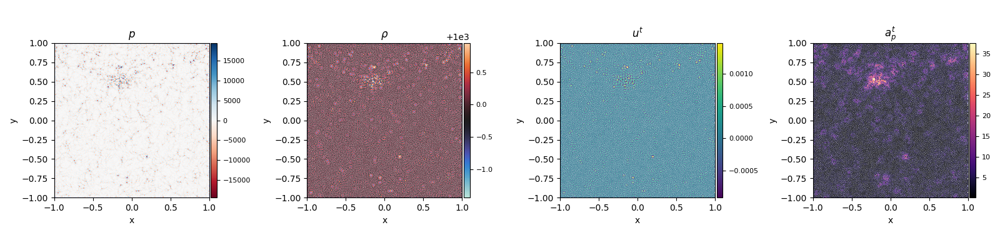

In [252]:
fig, axis = plt.subplots(1,4, figsize = (16,4), squeeze = False)


visualizationState = prepVisualizationState(solverState, config, grid = True)
# plotRegions(regions, axis[0,0])
# plotRegions(regions, axis[0,1])

s = 0.25
div = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)


pressurePlot = visualizeParticleQuantity(fig, axis[0,0], config, visualizationState, quantity =
                                      'pressure',
                                      mapping = '.x', s = s, 
                          scaling = 'sym', gridVisualization=False, cmap = 'RdBu', title = '$p$', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
rhoPlot = visualizeParticleQuantity(fig, axis[0,1], config, visualizationState, quantity = 
                                      'densities',
                                      mapping = '.x', s = s, 
                          scaling = 'RdBu', gridVisualization=False, cmap = 'icefire', streamLines = False, operation = None, title = '$\\rho$', plotBoth = False, which = 'fluid', midPoint = 1000)
velPlot = visualizeParticleQuantity(fig, axis[0,2], config, visualizationState, quantity = 
                                      B ,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'viridis', streamLines = False, operation = None, title = '$u^t$', plotBoth = False, which = 'fluid', midPoint = 0)

accelPlot = visualizeParticleQuantity(fig, axis[0,3], config, visualizationState, quantity = 
                                      a_p ,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=False, cmap = 'magma', streamLines = True, operation = None, title = '$a_p^t$', plotBoth = False, which = 'fluid', midPoint = 0)


fig.tight_layout()

In [181]:

residuals = []
A_sp = sp.coo_matrix((A[0].cpu().detach().to(torch.float64).numpy(), (A[1][0].cpu().detach().numpy(), A[1][1].cpu().detach().numpy())), shape = [solverState['fluid']['numParticles'], solverState['fluid']['numParticles']])
M_sp = sp.coo_matrix((M[0].cpu().detach().to(torch.float64).numpy(), (M[1][0].cpu().detach().numpy(), M[1][1].cpu().detach().numpy())), shape = [solverState['fluid']['numParticles'], solverState['fluid']['numParticles']])
rhs = B.cpu().detach().to(torch.float64).numpy()


# M = scipy.sparse.linalg.spilu(A_sp, drop_tol=1e-3)
# lo = scipy.sparse.linalg.LinearOperator(A_sp.shape, lambda x: M.solve(x))

# print(B.is_contiguous())
# print(A[0].is_contiguous())

p, iters, convergence_torch  = cg_sparse(A, B.cpu().to(torch.float64), torch.zeros_like(B.cpu()).to(torch.float64), rtol = 1e-4, maxiter = 512)
p = (p - p.mean()).to(torch.float32).to(solverState['fluid']['positions'].device)
print(f'Torch CG: {iters} iterations, {convergence_torch[-1][1]} residual, {p.max()} | {p.min()} | {p.mean()}')



# convergence = []
# xs = []
convergence = []
# p = scipy.sparse.linalg.bicgstab(A_sp, rhs, callback=lambda x: convergence.append([x.copy(), np.linalg.norm(A_sp.dot(x) - rhs)]), maxiter = 512, rtol = 1e-8, M = lo)
# p = scipy.sparse.linalg.cg(A_sp, rhs, callback=lambda x: convergence.append([x.copy(), np.linalg.norm(A_sp.dot(x) - rhs)]), maxiter = 512, rtol = 1e-4, M = lo)
p = scipy.sparse.linalg.cg(A_sp, rhs, callback=lambda x: convergence.append([x.copy(), np.linalg.norm(A_sp.dot(x) - rhs)]), maxiter = 512, rtol = 1e-4)
# display(A_sp)
# display(rhs)
# p = scipy.sparse.linalg.cg(A_sp, rhs)

# print(p)
p = torch.tensor(p[0] - p[0].mean(), device = solverState['fluid']['positions'].device, dtype = torch.float32)
print(f'SciPy CG: {iters} iterations, {convergence[-1][1]} residual, {p.max()} | {p.min()} | {p.mean()}')



Torch CG: 512 iterations, 0.1411032225269263 residual, 227125.328125 | -126272.171875 | -1.9073486328125e-06
SciPy CG: 512 iterations, 6.66297509960865e-06 residual, 906790.875 | -5014947.5 | -0.00048828125


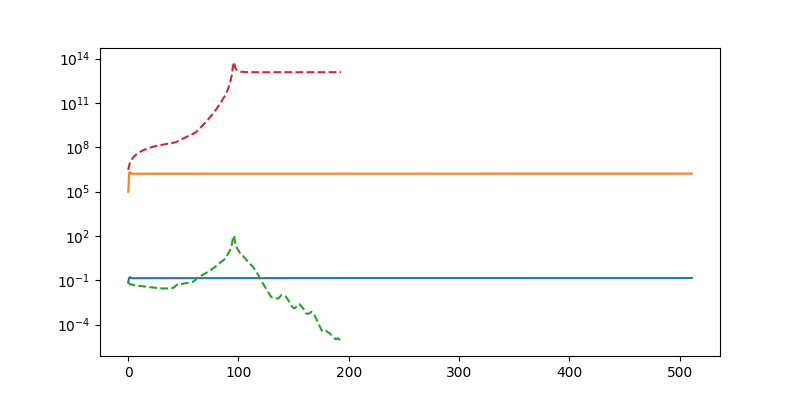

In [182]:

fig, axis = plt.subplots(1,1, figsize = (8,4), squeeze = False)

axis[0,0].semilogy([c[1].detach().cpu().numpy() for c in convergence_torch])
axis[0,0].semilogy([np.linalg.norm(c[0].detach().cpu().numpy()) for c in convergence_torch])

axis[0,0].semilogy([c[1] for c in convergence], ls = '--')
axis[0,0].semilogy([np.linalg.norm(c[0]) for c in convergence], ls = '--')


In [939]:
A_sp = sp.coo_matrix((A[0].cpu().detach().numpy(), (A[1][0].cpu().detach().numpy(), A[1][1].cpu().detach().numpy())), shape = [solverState['fluid']['numParticles'], solverState['fluid']['numParticles']])
M_sp = sp.coo_matrix((M[0].cpu().detach().numpy(), (M[1][0].cpu().detach().numpy(), M[1][1].cpu().detach().numpy())), shape = [solverState['fluid']['numParticles'], solverState['fluid']['numParticles']])
rhs = B.cpu().detach().numpy()


display(A_sp)
display(M_sp)

<16384x16384 sparse matrix of type '<class 'numpy.float32'>'
	with 973230 stored elements in COOrdinate format>

<16384x16384 sparse matrix of type '<class 'numpy.float32'>'
	with 16384 stored elements in COOrdinate format>

In [940]:
B.shape

torch.Size([16384])

In [941]:
bicg = []
bicgstab = []

def callback(x):
    bicg.append(np.linalg.norm(A_sp.dot(x) - rhs))

sol2_nostab = scipy.sparse.linalg.bicg(A_sp, rhs, callback=callback, maxiter = 512)

def callback(x):
    bicgstab.append(np.linalg.norm(A_sp.dot(x) - rhs))
sol2_nostab = scipy.sparse.linalg.bicgstab(A_sp, rhs, callback=callback, maxiter = 512)

# bicg_stab_no_prec = []
# bicg_stab_prec = []

# def callback(x):
#     bicg_stab_prec.append(np.linalg.norm(lp2.dot(x) - rhs))

# sol2_nostab = scipy.sparse.linalg.bicgstab(lp2, rhs, callback=callback, M=D)
# def callback(x):
#     bicg_stab_no_prec.append(np.linalg.norm(lp2.dot(x) - rhs))

# sol2_nostab = scipy.sparse.linalg.bicgstab(lp2, rhs, callback=callback)

# gmres = []
# # gmres_no_prec = []

# def callback(r):
#     gmres_prec.append(r)
# sol = scipy.sparse.linalg.gmres(A_sp, rhs, callback=callback, restart=50)

# def callback(r):
#     gmres_no_prec.append(r)
# sol = scipy.sparse.linalg.gmres(lp2, rhs, callback=callback, restart=50)

In [942]:
    residuals = []
    A_sp = sp.coo_matrix((A[0].cpu().detach().numpy(), (A[1][0].cpu().detach().numpy(), A[1][1].cpu().detach().numpy())), shape = [solverState['fluid']['numParticles'], solverState['fluid']['numParticles']])
    # M_sp = sp.coo_matrix((M[0].cpu().detach().numpy(), (M[1][0].cpu().detach().numpy(), M[1][1].cpu().detach().numpy())), shape = [solverState['fluid']['numParticles'], solverState['fluid']['numParticles']])
    rhs = B.cpu().detach().numpy()
    # p, iters, convergence1  = cg_sparse(A, B, torch.zeros_like(B), rtol = 1e-10, tol = 1e-8, maxiter = 256)

    convergence = []

    p = scipy.sparse.linalg.cg(A_sp, rhs, callback=lambda x: convergence.append(np.linalg.norm(A_sp.dot(x) - rhs)), maxiter = 512)
    # display(A_sp)
    # display(rhs)
    # p = scipy.sparse.linalg.cg(A_sp, rhs)

In [943]:

cg = []
def callback(x):
    cg.append(np.linalg.norm(A_sp.dot(x) - rhs))

sol2_nostab = scipy.sparse.linalg.cg(A_sp, rhs, callback=callback, maxiter = 512)

print(cg)

[34909.62, 33194.56, 65365.58, 101414.49, 80791.91, 45341.93, 29941.41, 26942.174, 31566.531, 39042.094, 38029.457, 29946.732, 24476.578, 23727.705, 25930.828, 27905.846, 27211.03, 25492.96, 25484.771, 26933.68, 27776.383, 27116.115, 26455.98, 27420.998, 29942.896, 31209.984, 29541.143, 26992.408, 26986.04, 30910.42, 37737.523, 44322.133, 47968.31, 50254.48, 54323.473, 61575.766, 71090.87, 82417.28, 96593.56, 116761.266, 138612.36, 153412.92, 164039.8, 166094.06, 151421.73, 154897.34, 167988.58, 179009.75, 188956.66, 193460.39, 199211.08, 196474.78, 184406.12, 175155.83, 174642.4, 196178.77, 227056.78, 252020.27, 259672.94, 250306.45, 255234.83, 286663.97, 309867.4, 315318.56, 349139.0, 394931.0, 458703.97, 542669.6, 610197.8, 696165.0, 772006.9, 880260.25, 1005510.2, 1163535.0, 1325164.9, 1523643.9, 1794962.1, 2116209.5, 2545276.2, 3068091.8, 3726899.0, 4614673.0, 5855398.0, 7723204.5, 10539275.0, 14949967.0, 22191272.0, 39589664.0, 123353880.0, 92614370.0, 363995800.0, 112619450.0, 1

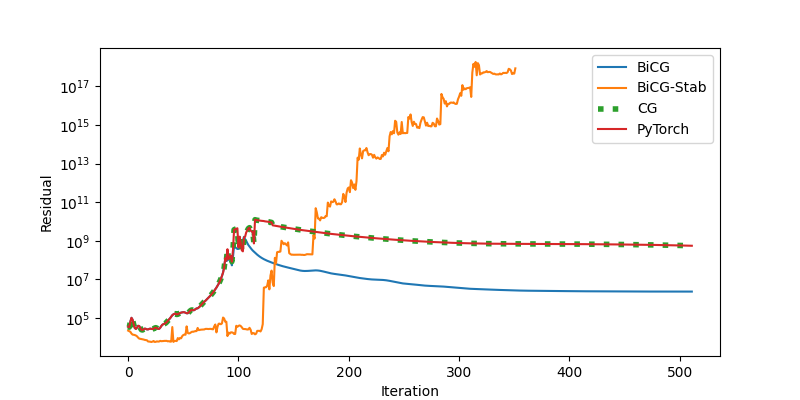

In [944]:
fig, axis = plt.subplots(1,1, figsize = (8,4), squeeze = False)

# axis[0,0].semilogy([c.detach().cpu().numpy() for c in convergence])
axis[0,0].semilogy(bicg, label = 'BiCG')
axis[0,0].semilogy(bicgstab, label = 'BiCG-Stab')
# axis[0,0].semilogy(gmres, label = 'GMRES')
axis[0,0].semilogy(cg, label = 'CG', ls = ':', lw = 4)

# axis[0,0].semilogy([c.detach().cpu().numpy() for c in convergence], label = 'PyTorch')
axis[0,0].semilogy([c for c in convergence], label = 'PyTorch')


axis[0,0].set_xlabel('Iteration')
axis[0,0].set_ylabel('Residual')

axis[0,0].legend()



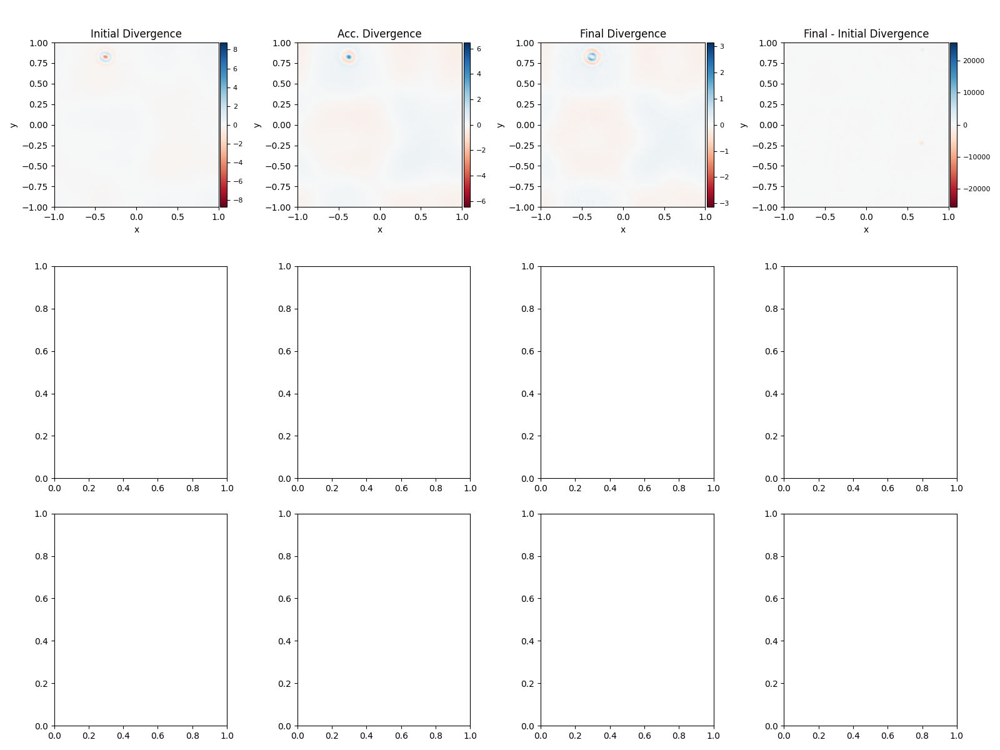

In [945]:
fig, axis = plt.subplots(3,4, figsize = (16,12), squeeze = False)
visualizationState = prepVisualizationState(solverState, config, grid = True)
b = solverState['fluid']['advectionDivergence'] / solverState['dt']
# residualPlot_00 = visualizeParticleQuantity(fig, axis[0,0], config, visualizationState, quantity =
#                                     b, mapping = '.x', s = s, 
#                         scaling = 'sym', gridVisualization=True, cmap = 'RdBu', title = f'Iteration {i}', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
# print(f'Iteration {i} mean residual: {residuals[i].mean()}, min: {residuals[i].min()}, max: {residuals[i].max()}')


for i, (ax, r) in enumerate(zip(axis.flatten()[4:], residuals if len(residuals) < 8 else residuals[-8:])):
    residualPlot_00 = visualizeParticleQuantity(fig, ax, config, visualizationState, quantity =
                                      r - b, mapping = '.x', s = s, 
                          scaling = 'sym', gridVisualization=False, cmap = 'RdBu', title = f'Iteration {i}', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
    print(f'Iteration {i} mean residual: {(r-b).mean()}, min: {(r - b).min()}, max: {(r - b ).max()}')

residualPlot_00 = visualizeParticleQuantity(fig, axis.flatten()[0], config, visualizationState, quantity =
                                    initDiv, mapping = '.x', s = s, 
                        scaling = 'sym', gridVisualization=True, cmap = 'RdBu', title = f'Initial Divergence', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
residualPlot_00 = visualizeParticleQuantity(fig, axis.flatten()[1], config, visualizationState, quantity =
                                    accDiv, mapping = '.x', s = s, 
                        scaling = 'sym', gridVisualization=True, cmap = 'RdBu', title = f'Acc. Divergence', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
residualPlot_00 = visualizeParticleQuantity(fig, axis.flatten()[2], config, visualizationState, quantity =
                                    finalDiv, mapping = '.x', s = s, 
                        scaling = 'sym', gridVisualization=True, cmap = 'RdBu', title = f'Final Divergence', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
residualPlot_00 = visualizeParticleQuantity(fig, axis.flatten()[3], config, visualizationState, quantity =
                                    finalDiv/initDiv, mapping = '.x', s = s, 
                        scaling = 'sym', gridVisualization=True, cmap = 'RdBu', title = f'Final - Initial Divergence', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)


fig.tight_layout()

In [946]:
finalDiv/accDiv

tensor([ 2.6700, -1.3211,  1.8736,  ...,  2.4875,  0.6518, -1.0003],
       device='cuda:0')

In [947]:
solverState = copy.deepcopy(initialState)

# solverState['fluid']['velocities'][:,0] = torch.sin(solverState['fluid']['positions'][:,1] * 2 * np.pi)
# solverState['fluid']['velocities'][:,1] = 0
solverState['fluid']['pressure'] = torch.zeros_like(solverState['fluid']['densities'])


In [273]:
solverState['fluid'].keys()

dict_keys(['positions', 'areas', 'densities', 'numParticles', 'velocities', 'masses', 'supports', 'datastructure', 'neighborhood', 'numNeighbors', 'velocityDiffusion', 'gravityAccel', 'advection', 'predictedAcceleration', 'predictedVelocities', 'actualArea', 'sourceTerm', 'pressureB', 'pressureA', 'alpha', 'pressureAccel', 'residual', 'convergence_density', 'accelerations', 'advectionVelocities', 'velocityDivergence', 'advectionDivergence', 'pressure'])

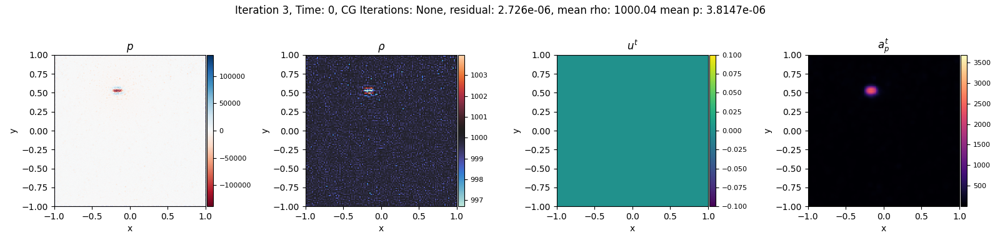

In [296]:
fig, axis = plt.subplots(1,4, figsize = (16,4), squeeze = False)


visualizationState = prepVisualizationState(solverState, config, grid = True)
# plotRegions(regions, axis[0,0])
# plotRegions(regions, axis[0,1])

s = 0.25
div = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)


pressurePlot = visualizeParticleQuantity(fig, axis[0,0], config, visualizationState, quantity =
                                      'pressure',
                                      mapping = '.x', s = s, 
                          scaling = 'sym', gridVisualization=False, cmap = 'RdBu', title = '$p$', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
rhoPlot = visualizeParticleQuantity(fig, axis[0,1], config, visualizationState, quantity = 
                                      'densities',
                                      mapping = '.x', s = s, 
                          scaling = 'RdBu', gridVisualization=True, cmap = 'icefire', streamLines = False, operation = None, title = '$\\rho$', plotBoth = False, which = 'fluid', midPoint = 1000)
velPlot = visualizeParticleQuantity(fig, axis[0,2], config, visualizationState, quantity = 
                                      'velocities' ,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=True, cmap = 'viridis', streamLines = False, operation = None, title = '$u^t$', plotBoth = False, which = 'fluid', midPoint = 0)

accelPlot = visualizeParticleQuantity(fig, axis[0,3], config, visualizationState, quantity = 
                                      a_p,
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=True, cmap = 'magma', streamLines = False, operation = None, title = '$a_p^t$', plotBoth = False, which = 'fluid', midPoint = 0)

fig.suptitle(f'Iteration {i}, Time: {solverState["time"]:.4g}, CG Iterations: {iters}, residual: {convergence[-1][-1]:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressure"].mean():.6g}')
        

fig.tight_layout()

In [297]:
solverState = copy.deepcopy(initialState)
# solverState['fluid']['velocities'][:,0] = 0
# solverState['fluid']['velocities'][:,0] = torch.sin(solverState['fluid']['positions'][:,1] * 2 * np.pi)
# solverState['fluid']['velocities'][:,1] = 0
# solverState['fluid']['pressure'] = torch.zeros_like(solverState['fluid']['densities'])


solverState['dt'] = 1e-4
config['timestep']['dt'] = solverState['dt']

for i in tqdm(range(4096)):
    solverState['time'] += perennialState['dt']
    solverState['timestep'] += 1

    searchNeighbors(solverState, config)

    solverState['fluid']['densities'], _ = callModule(solverState, computeDensity, config, 'fluid')
    solverState['fluid']['gravityAccel'] = computeGravity(solverState['fluid'], config)
    solverState['fluid']['velocityDiffusion'], _ = callModule(solverState, computeViscosity, config, 'fluid')
    solverState['fluid']['advection'] = solverState['fluid']['gravityAccel'] + solverState['fluid']['velocityDiffusion']
    # solverState['fluid']['advection'][:,0] += torch.sin(2 * np.pi * solverState['fluid']['positions'][:,1]) * solverState['dt']

    
    solverState['fluid']['advectionVelocities'] = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']
    solverState['fluid']['velocityDivergence'] = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)
    solverState['fluid']['advectionDivergence'] = computeAdvectionDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)


    solverState['fluid']['pressure'], iters, convergence, residuals, A, B, M = solveISPH(solverState['fluid'], solverState['fluid'], config, solverState['fluid']['neighborhood'])

    # solverState['fluid']['pressure'] = - solverState['fluid']['pressure']

    a_p = -sphOperationStates(solverState['fluid'], solverState['fluid'], (solverState['fluid']['pressure'], solverState['fluid']['pressure']), operation = 'gradient', gradientMode='symmetric', neighborhood= solverState['fluid']['neighborhood']) / solverState['fluid']['densities'].view(-1,1)

    finalVelocities = solverState['fluid']['advectionVelocities']  + a_p* solverState['dt']
    finalDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (finalVelocities, finalVelocities), neighborhood=solverState['fluid']['neighborhood'], operation='divergence')


    stateA = solverState['fluid']
    stateB = solverState['fluid']
    neighborhood = stateA['neighborhood']

    initDiv = sphOperationStates(stateA, stateB, (stateA['velocities'], stateB['velocities']), neighborhood=neighborhood, operation='divergence')
    advDiv = sphOperationStates(stateA, stateB, (stateA['advectionVelocities'], stateB['advectionVelocities']), neighborhood=neighborhood, operation='divergence')
    accDiv = sphOperationStates(stateA, stateB, (solverState['dt'] * a_p, solverState['dt'] * a_p), neighborhood=neighborhood, operation='divergence')
    finalDiv = sphOperationStates(stateA, stateB, (finalVelocities, finalVelocities), neighborhood=neighborhood, operation='divergence')


    solverState['fluid']['velocities'] = finalVelocities
    solverState['fluid']['positions'] += finalVelocities * solverState['dt']# + a_p* solverState['dt'] * solverState['dt']
    div = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)



    print(f'Iteration: {i}, Divergence: {div.min()} | {div.max()}, Pressure: {solverState["fluid"]["pressure"].min()} | {solverState["fluid"]["pressure"].max()}, densities: {solverState["fluid"]["densities"].min()} | {solverState["fluid"]["densities"].max()}')

    # print(f'Initial Divergence:   {initDiv.min()} | {initDiv.max()} | {initDiv.mean()} | {initDiv}')
    print(f'Advection Divergence: {advDiv.min()} | {advDiv.max()} | {advDiv.mean()} | {advDiv}')
    print(f'Accel Divergence:     {accDiv.min()} | {accDiv.max()} | {accDiv.mean()} | {accDiv}')
    # print(f'Final Divergence:     {finalDiv.min()} | {finalDiv.max()} | {finalDiv.mean()} | {finalDiv}')
    # print(f'Residual:             {(advDiv - accDiv).min()} | {(advDiv - accDiv).max()} | {(advDiv - accDiv).mean()} | {(advDiv - accDiv)}')

    if i % 16 == 0:
        searchNeighbors(solverState, config)
        visualizationState = prepVisualizationState(solverState, config, grid = True)
        # visualizationState = prepVisualizationState(perennialState, config)
        # div = computeMomentumEquation(perennialState['fluid'], perennialState['fluid'], perennialState['fluid']['neighborhood'], config)
        
        # div = sphOperationStates(perennialState['fluid'], perennialState['fluid'], (perennialState['fluid']['velocities'], perennialState['fluid']['velocities']), operation = 'divergence', gradientMode='difference', neighborhood=perennialState['fluid']['neighborhood'])
        updatePlot(pressurePlot, visualizationState, 'pressure')
        updatePlot(rhoPlot, visualizationState, 'densities')
        updatePlot(velPlot, visualizationState, 'velocities')
        updatePlot(accelPlot, visualizationState, a_p)
        
        fig.suptitle(f'Iteration {i}, Time: {solverState["time"]:.4g}, CG Iterations: {iters}, residual: {convergence[-1][-1]:.4g}, mean rho: {solverState["fluid"]["densities"].mean():.6g} mean p: {solverState["fluid"]["pressure"].mean():.6g}')
        
        fig.canvas.draw()
        fig.canvas.flush_events()
        # exportPlot(solverState, config, fig)

  0%|          | 0/4096 [00:00<?, ?it/s]

Divergence-Free Source Term: 7883.484375 | 0.006217761896550655 | 0.00041985511779785156
Incompressible Source Term: 0.01810492016375065 | 6.103515914901436e-08 | -3.786825982388109e-05
tensor(-3.7868e-05, device='cuda:0')
Current Density: 1000.4196166992188 | 981.8994140625 | 1000.037841796875
Advection Density: 1000.4247436523438 | 981.8950805664062 | 1000.037841796875
Torch CG: 92 iterations, 6.3501223726538356e-06 residual, 912569.6875 | -5008933.5 | -0.000732421875
Iteration: 0, Divergence: -107.2194595336914 | 1.1421856880187988, Pressure: -5008933.5 | 912569.6875, densities: 981.8994140625 | 1000.4196166992188
Advection Divergence: -0.7883484363555908 | 0.7264362573623657 | 5.702895577996969e-08 | tensor([ 0.0445,  0.2149, -0.1799,  ..., -0.1206, -0.1014, -0.0416],
       device='cuda:0')
Accel Divergence:     -107.26360321044922 | 0.8967551589012146 | 0.0017438586801290512 | tensor([ 0.5545, -0.3630,  0.4943,  ...,  0.7691, -0.4655,  0.5970],
       device='cuda:0')
Divergence-

RuntimeError: shape mismatch: value tensor of shape [16384] cannot be broadcast to indexing result of shape [0]

  0%|          | 0/256 [00:00<?, ?it/s]

[0.1583489626646042, 0.07733796536922455, 0.052843622863292694, 0.04024842008948326, 0.03235901892185211, 0.026884004473686218, 0.02276621013879776, 0.01958506740629673, 0.017193052917718887, 0.01533567439764738, 0.013764981180429459, 0.012241830118000507, 0.010959604755043983, 0.009750910103321075, 0.008801978081464767, 0.008092448115348816, 0.007503774017095566, 0.00699051795527339, 0.006362928077578545, 0.005470598116517067, 0.005397814325988293, 0.004585231188684702, 0.004335539415478706, 0.003939945250749588, 0.026406535878777504, 0.003462046617642045, 0.003168828086927533, 0.003111028578132391, 0.0030905224848538637, 0.002684845821931958, 0.0024267639964818954, 0.0025631713215261698, 0.0024949756916612387, 0.0018495729891583323, 0.0017644591862335801, 0.0011260759783908725, 0.0014113852521404624, 0.0013523445231840014, 0.0010464346269145608, 0.001120393630117178, 0.0010509752901270986, 0.0009478653664700687, 0.0008552554063498974, 0.0008296513697132468, 0.0007834323332644999, 0.0

RuntimeError: shape mismatch: value tensor of shape [16384] cannot be broadcast to indexing result of shape [3903]

In [ ]:
priorState = None
for i in tqdm(range(4096)):
    if 'shiftAmount' in perennialState['fluid']:
        del perennialState['fluid']['shiftAmount']
    perennialState, priorState, *updates = integrate(simulationStep, perennialState, config, previousStep= priorState)
    # dx, _ = solveShifting(perennialState, config)
    # numNeighbors = perennialState['fluid']['neighborhood']['numNeighbors']
    # perennialState['fluid']['shiftAmount'] = dx
    # perennialState['fluid']['positions'][numNeighbors > 5] += dx[numNeighbors > 5]
    # if config['compute']['checkNaN']:
    #     checkNaN(perennialState['fluid']['positions'], 'positions')
    #     checkNaN(perennialState['fluid']['shiftAmount'], 'shiftAmount')
    perennialState['time'] += perennialState['dt']
    perennialState['timestep'] += 1
    # print(f'Incompressible: Iters: {len(perennialState["fluid"]["convergence_density"])}, residual: {perennialState["fluid"]["convergence_density"][-1]:.4e}, Divergence-Free: Iters: {len(perennialState["fluid"]["convergence_divergence"])}, residual: {perennialState["fluid"]["convergence_divergence"][-1]:.4e}')

    if i % 128 == 0:
        searchNeighbors(perennialState, config)
        visualizationState = prepVisualizationState(perennialState, config)
        div = computeMomentumEquation(perennialState['fluid'], perennialState['fluid'], perennialState['fluid']['neighborhood'], config)
        
        # div = sphOperationStates(perennialState['fluid'], perennialState['fluid'], (perennialState['fluid']['velocities'], perennialState['fluid']['velocities']), operation = 'divergence', gradientMode='difference', neighborhood=perennialState['fluid']['neighborhood'])
        updatePlot(indexPlot, visualizationState, 'velocities')
        updatePlot(quantPlot, visualizationState, 'pressureIncompressible')
        updatePlot(l2Plot, visualizationState, div)
        
        
        fig.canvas.draw()
        fig.canvas.flush_events()
        exportPlot(perennialState, config, fig)


        
        E_k0 =  (0.5 * particleState['areas'] * particleState['densities'] * torch.linalg.norm(initialVelocities, dim = -1)**2).sum().detach().cpu().numpy()
        E_k = (0.5 * torch.sum(perennialState['fluid']['areas'] * perennialState['fluid']['densities'] * torch.linalg.norm(perennialState['fluid']['velocities'], dim = 1)**2)).sum().detach().cpu().numpy()
        nu_total = np.log(E_k / E_k0) / (-4 *  perennialState['time'] * k**2 )
        Re = u_mag * 2 / nu_total


        fig.suptitle(f'step {perennialState["timestep"]}, time {perennialState["time"]:.4g}, dt {perennialState["dt"]:.2e} ptcls: {nx}x{nx} = {nx**2}, $\\alpha = {config["diffusion"]["alpha"]:.2e}$, $\\nu_{{sph}} = {config["diffusion"]["nu_sph"]}$\ndiv: {div.sum():.2f}, $\\rho = {perennialState["fluid"]["densities"].mean().cpu().detach().numpy():.2f}$, Incompressible: Iters: {len(perennialState["fluid"]["convergence_density"])}, residual: {perennialState["fluid"]["convergence_density"][-1]:.4e}, Divergence-Free: Iters: {len(perennialState["fluid"]["convergence_divergence"])}, residual: {perennialState["fluid"]["convergence_divergence"][-1]:.4e}\n E_k0: {E_k0:.2f}, E_k: {E_k:.2f}, $\\nu = {nu_total:.2e}$, $Re = {Re:.4g}$')
        # fig.suptitle(f'step {perennialState["timestep"]}, time {perennialState["time"]:.2f}, dt {perennialState["dt"]:.2e} ptcls: {nx}x{nx} = {nx**2}, $\\alpha = {config["diffusion"]["alpha"]}$, $\\nu_{{sph}} = {config["diffusion"]["nu_sph"]}$\ndiv: {div.sum()}, $\\rho = {perennialState["fluid"]["densities"].mean().cpu().detach().numpy():.2f}$')

        
        
        fig.canvas.draw()
        fig.canvas.flush_events()
        exportPlot(perennialState, config, fig)



In [ ]:
def computeFinalDivergence(stateA, stateB, neighborhood, simConfig):
    with record_function("[SPH] - Fluid Divergence ($nabla cdot \\bar{v}$)"):
        divergence = sphOperationStates(stateA, stateB, (stateA['finalVelocities'], stateB['finalVelocities']), neighborhood=neighborhood, operation='divergence')
        return divergence
    


print(f'Initial Divergence: {solverState["fluid"]["velocityDivergence"].abs().max()}, mean: {solverState["fluid"]["velocityDivergence"].abs().mean()}')
# div = computeFinalDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)

Initial Divergence: 1.1614457368850708, mean: 0.46628260612487793


In [ ]:
from diffSPH.v2.simulationSchemes.dfsph import callModule, computeDensity, computeGravity, computeViscosity, sphOperationStates, scatter_sum
solverState = copy.deepcopy(initialState)

# solverState['fluid']['velocities'][:,0] =  -torch.clamp(1 - (solverState['fluid']['positions'][:,0]**2 + solverState['fluid']['positions'][:,1]**2), min = 0) * 10
# solverState['fluid']['velocities'][:,1] =  -torch.clamp(1 - (solverState['fluid']['positions'][:,0]**2 + solverState['fluid']['positions'][:,1]**2), min = 0) * 10
searchNeighbors(solverState, config)
solverState['dt'] = 0.01
config['timestep']['dt'] = 0.01

for i in range(32):
    
    solverState['fluid']['densities'], _ = callModule(solverState, computeDensity, config, 'fluid')
    solverState['fluid']['gravityAccel'] = computeGravity(solverState['fluid'], config)
    solverState['fluid']['velocityDiffusion'], _ = callModule(solverState, computeViscosity, config, 'fluid')
    solverState['fluid']['advection'] = solverState['fluid']['gravityAccel'] + solverState['fluid']['velocityDiffusion']
    solverState['fluid']['advectionVelocities'] = solverState['fluid']['velocities'] + solverState['fluid']['advection'] * solverState['dt']
    solverState['fluid']['velocityDivergence'] = computeDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)
    solverState['fluid']['advectionDivergence'] = computeAdvectionDivergence(solverState['fluid'], solverState['fluid'], solverState['fluid']['neighborhood'], config)


    p, iters, convergence = solveISPH(solverState['fluid'], solverState['fluid'], config, solverState['fluid']['neighborhood'])

    a_p = -sphOperationStates(solverState['fluid'], solverState['fluid'], (p, p), operation = 'gradient', gradientMode='symmetric', neighborhood= solverState['fluid']['neighborhood']) / solverState['fluid']['densities'].view(-1,1)
    finalVelocities = solverState['fluid']['advectionVelocities'] + a_p * solverState['dt']
    finalDivergence = sphOperationStates(solverState['fluid'], solverState['fluid'], (finalVelocities, finalVelocities), neighborhood=solverState['fluid']['neighborhood'], operation='divergence')

    solverState['fluid']['velocities'] = finalVelocities


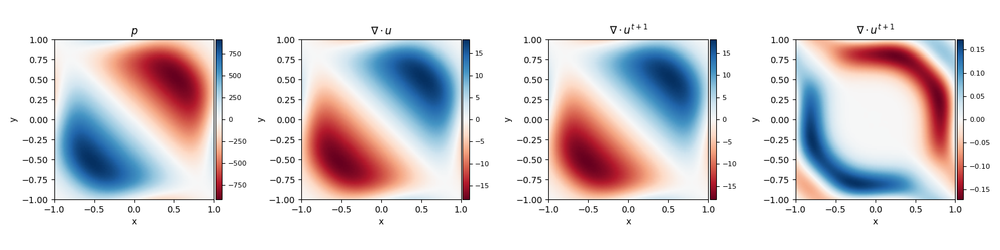

In [ ]:
solverState['pressures'] = torch.zeros_like(solverState['fluid']['densities'])

In [ ]:
stateA = solverState['fluid']
stateB = solverState['fluid']
neighborhood = stateA['neighborhood']

i,j = neighborhood['indices']
rij = neighborhood['distances']
hij = neighborhood['supports']
xij = neighborhood['vectors']
gradKernels = neighborhood['gradients']
pA = stateA['pressures']
pB = stateB['pressures']

quotient = (rij * hij + 1e-7 * hij)
kernelApproximation = torch.linalg.norm(gradKernels, dim = -1) /  quotient
kernelApproximation = torch.einsum('nd, nd -> n', gradKernels, -xij)/  quotient# * rij * hij

In [ ]:
Aij = pA[i] - pB[j]
massTerm = stateA['masses'][j] / (stateA['densities'][i] + stateB['densities'][j])
dimTerm = config['domain']['dim'] * 2 + 2

laplacianTerm = dimTerm * massTerm * kernelApproximation

aii = scatter_sum(laplacianTerm, i, dim = 0, dim_size = stateA['positions'].shape[0])

mask = i == j

A = laplacianTerm
A[mask] = aii

B = solverState['fluid']['advectionDivergence'] / solverState['dt']**3

A = (laplacianTerm, (i,j), stateA['numParticles'])

In [ ]:
p, iters, convergence = bicg(A, -B, torch.zeros_like(B), rtol = 1e-10, tol = 1e-8, maxiter = 512)

print(iters, convergence)

p, iters, convergence = bicg(A, -B, p, rtol = 1e-10, tol = 1e-8, maxiter = 512)

Iter 0, Residual: 1567563648.0
Iter 1, Residual: 32864440.0
Iter 2, Residual: 5100007.5
Iter 3, Residual: 977547.5625
Iter 4, Residual: 199048.65625
Iter 5, Residual: 41491.64453125
Iter 6, Residual: 8738.3974609375
Iter 7, Residual: 1852.215576171875
Iter 8, Residual: 394.5318298339844
Iter 9, Residual: 84.29361724853516
Iter 10, Residual: 18.063350677490234
Iter 11, Residual: 3.887315511703491
Iter 12, Residual: 0.8368783593177795
Iter 13, Residual: 0.18033309280872345
14 [tensor(32864442., device='cuda:0'), tensor(5100006., device='cuda:0'), tensor(977554.1875, device='cuda:0'), tensor(199046.0469, device='cuda:0'), tensor(41495.4102, device='cuda:0'), tensor(8747.5312, device='cuda:0'), tensor(1882.0022, device='cuda:0'), tensor(541.1484, device='cuda:0'), tensor(366.3199, device='cuda:0'), tensor(358.9917, device='cuda:0'), tensor(358.6536, device='cuda:0'), tensor(359.9285, device='cuda:0'), tensor(361.6763, device='cuda:0'), tensor(361.5761, device='cuda:0')]
Iter 0, Residual: 3

In [ ]:

# p, convergence, iters, residual = BiCGStab_wJacobi(A, B, torch.zeros_like(B), i, j)

# print(f'Iterations: {iters}, Residual: {residual}, {convergence}')
# print(f'p: {p}, min: {p.min()}, max: {p.max()}, mean: {p.mean()}')

In [ ]:
a_p = -sphOperationStates(stateA, stateB, (p, p), operation = 'gradient', gradientMode='symmetric', neighborhood= neighborhood) / stateA['densities'].view(-1,1)
finalVelocities = stateA['advectionVelocities'] + a_p * solverState['dt']
finalDivergence = sphOperationStates(stateA, stateB, (finalVelocities, finalVelocities), neighborhood=neighborhood, operation='divergence')



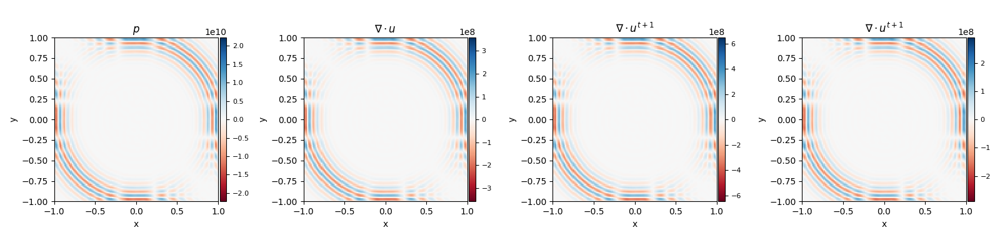

In [ ]:
from diffSPH.v2.plotting import prepVisualizationState, visualizeParticleQuantity
from diffSPH.v2.plotting import exportPlot, postProcessPlot
fig, axis = plt.subplots(1,4, figsize = (16,4), squeeze = False)

visualizationState = prepVisualizationState(solverState, config, grid = True)
# plotRegions(regions, axis[0,0])
# plotRegions(regions, axis[0,1])

s = 0.25

xVelPlot = visualizeParticleQuantity(fig, axis[0,0], config, visualizationState, quantity =
                                      p,
                                      mapping = '.x', s = s, 
                          scaling = 'sym', gridVisualization=True, cmap = 'RdBu', title = '$p$', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = False)
yVelPlot = visualizeParticleQuantity(fig, axis[0,1], config, visualizationState, quantity = 
                                      'velocityDivergence',
                                      mapping = '.y', s = s, 
                          scaling = 'sym', gridVisualization=True, cmap = 'RdBu', streamLines = False, operation = None, title = '$\\nabla \\cdot u$', plotBoth = False, which = 'fluid', midPoint = 0)

velPlot = visualizeParticleQuantity(fig, axis[0,2], config, visualizationState, quantity = 
                                      finalDivergence,
                                      mapping = 'L2', s = s, 
                          scaling = 'sym', gridVisualization=True, cmap = 'RdBu', streamLines = False, operation = None, title = '$\\nabla \\cdot u^{t+1}$', plotBoth = False, which = 'fluid', midPoint = 0)
velPlot = visualizeParticleQuantity(fig, axis[0,3], config, visualizationState, quantity = 
                                      finalDivergence - solverState['fluid']['velocityDivergence'],
                                      mapping = 'L2', s = s, 
                          scaling = 'sym', gridVisualization=True, cmap = 'RdBu', streamLines = False, operation = None, title = '$\\nabla \\cdot u^{t+1}$', plotBoth = False, which = 'fluid', midPoint = 0)



fig.tight_layout()

# simulationState['fluid']['actualArea'] = simulationState['fluid']['masses'] / simulationState['fluid']['densities']
# 



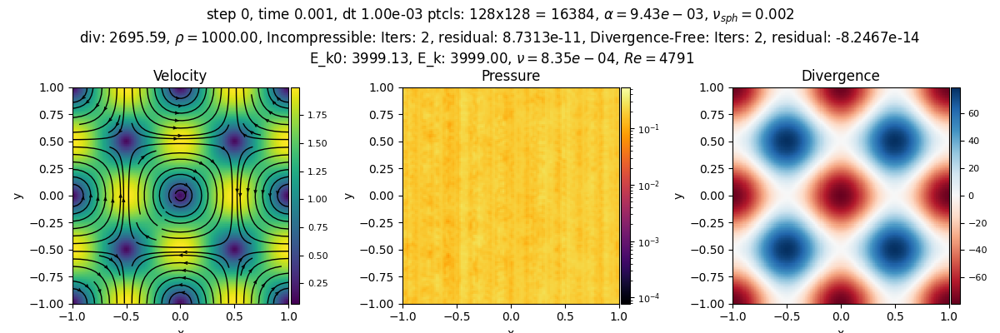

In [ ]:
from diffSPH.v2.plotting import prepVisualizationState, visualizeParticleQuantity
from diffSPH.v2.plotting import exportPlot, postProcessPlot
fig, axis = plt.subplots(1,3, figsize = (12,4), squeeze = False)

visualizationState = prepVisualizationState(perennialState, config, grid = True)
# plotRegions(regions, axis[0,0])
# plotRegions(regions, axis[0,1])

s = 0.25

indexPlot = visualizeParticleQuantity(fig, axis[0,0], config, visualizationState, quantity =
                                      'velocities',
                                      mapping = 'L2', s = s, 
                          scaling = 'lin', gridVisualization=True, cmap = 'viridis', title = 'Velocity', which = 'fluid', plotBoth = False, midPoint = 0, streamLines = True)
quantPlot = visualizeParticleQuantity(fig, axis[0,1], config, visualizationState, quantity = 
                                      'pressureIncompressible',
                                      mapping = '.y', s = s, 
                          scaling = 'log', gridVisualization=True, cmap = 'inferno', streamLines = False, operation = None, title = 'Pressure', plotBoth = False, which = 'fluid', midPoint = 1000)

l2Plot = visualizeParticleQuantity(fig, axis[0,2], config, visualizationState, quantity = 
                                      div,
                                      mapping = '.x', s = s, 
                          scaling = 'sym', gridVisualization=True, cmap = 'RdBu', streamLines = False, operation = None, title = 'Divergence', plotBoth = False, which = 'fluid', midPoint = 0)

E_k0 =  (0.5 * particleState['areas'] * particleState['densities'] * torch.linalg.norm(initialVelocities, dim = -1)**2).sum().detach().cpu().numpy()
E_k = (0.5 * torch.sum(perennialState['fluid']['areas'] * perennialState['fluid']['densities'] * torch.linalg.norm(perennialState['fluid']['velocities'], dim = 1)**2)).sum().detach().cpu().numpy()
nu_total = np.log(E_k / E_k0) / (-4 *  perennialState['time'] * k**2 )
Re = u_mag * 2 / nu_total

fig.suptitle(f'step {perennialState["timestep"]}, time {perennialState["time"]:.4g}, dt {perennialState["dt"]:.2e} ptcls: {nx}x{nx} = {nx**2}, $\\alpha = {config["diffusion"]["alpha"]:.2e}$, $\\nu_{{sph}} = {config["diffusion"]["nu_sph"]}$\ndiv: {div.sum():.2f}, $\\rho = {perennialState["fluid"]["densities"].mean().cpu().detach().numpy():.2f}$, Incompressible: Iters: {len(priorState["fluid"]["convergence_density"])}, residual: {priorState["fluid"]["convergence_density"][-1]:.4e}, Divergence-Free: Iters: {len(priorState["fluid"]["convergence_divergence"])}, residual: {priorState["fluid"]["convergence_divergence"][-1]:.4e}\n E_k0: {E_k0:.2f}, E_k: {E_k:.2f}, $\\nu = {nu_total:.2e}$, $Re = {Re:.4g}$')

fig.tight_layout()

# simulationState['fluid']['actualArea'] = simulationState['fluid']['masses'] / simulationState['fluid']['densities']
# 



In [ ]:
priorState = None
for i in tqdm(range(4096)):
    if 'shiftAmount' in perennialState['fluid']:
        del perennialState['fluid']['shiftAmount']
    perennialState, priorState, *updates = integrate(simulationStep, perennialState, config, previousStep= priorState)
    # dx, _ = solveShifting(perennialState, config)
    # numNeighbors = perennialState['fluid']['neighborhood']['numNeighbors']
    # perennialState['fluid']['shiftAmount'] = dx
    # perennialState['fluid']['positions'][numNeighbors > 5] += dx[numNeighbors > 5]
    # if config['compute']['checkNaN']:
    #     checkNaN(perennialState['fluid']['positions'], 'positions')
    #     checkNaN(perennialState['fluid']['shiftAmount'], 'shiftAmount')
    perennialState['time'] += perennialState['dt']
    perennialState['timestep'] += 1
    # print(f'Incompressible: Iters: {len(perennialState["fluid"]["convergence_density"])}, residual: {perennialState["fluid"]["convergence_density"][-1]:.4e}, Divergence-Free: Iters: {len(perennialState["fluid"]["convergence_divergence"])}, residual: {perennialState["fluid"]["convergence_divergence"][-1]:.4e}')

    if i % 128 == 0:
        searchNeighbors(perennialState, config)
        visualizationState = prepVisualizationState(perennialState, config)
        div = computeMomentumEquation(perennialState['fluid'], perennialState['fluid'], perennialState['fluid']['neighborhood'], config)
        
        # div = sphOperationStates(perennialState['fluid'], perennialState['fluid'], (perennialState['fluid']['velocities'], perennialState['fluid']['velocities']), operation = 'divergence', gradientMode='difference', neighborhood=perennialState['fluid']['neighborhood'])
        updatePlot(indexPlot, visualizationState, 'velocities')
        updatePlot(quantPlot, visualizationState, 'pressureIncompressible')
        updatePlot(l2Plot, visualizationState, div)
        
        
        E_k0 =  (0.5 * particleState['areas'] * particleState['densities'] * torch.linalg.norm(initialVelocities, dim = -1)**2).sum().detach().cpu().numpy()
        E_k = (0.5 * torch.sum(perennialState['fluid']['areas'] * perennialState['fluid']['densities'] * torch.linalg.norm(perennialState['fluid']['velocities'], dim = 1)**2)).sum().detach().cpu().numpy()
        nu_total = np.log(E_k / E_k0) / (-4 *  perennialState['time'] * k**2 )
        Re = u_mag * 2 / nu_total


        fig.suptitle(f'step {perennialState["timestep"]}, time {perennialState["time"]:.4g}, dt {perennialState["dt"]:.2e} ptcls: {nx}x{nx} = {nx**2}, $\\alpha = {config["diffusion"]["alpha"]:.2e}$, $\\nu_{{sph}} = {config["diffusion"]["nu_sph"]}$\ndiv: {div.sum():.2f}, $\\rho = {perennialState["fluid"]["densities"].mean().cpu().detach().numpy():.2f}$, Incompressible: Iters: {len(perennialState["fluid"]["convergence_density"])}, residual: {perennialState["fluid"]["convergence_density"][-1]:.4e}, Divergence-Free: Iters: {len(perennialState["fluid"]["convergence_divergence"])}, residual: {perennialState["fluid"]["convergence_divergence"][-1]:.4e}\n E_k0: {E_k0:.2f}, E_k: {E_k:.2f}, $\\nu = {nu_total:.2e}$, $Re = {Re:.4g}$')
        # fig.suptitle(f'step {perennialState["timestep"]}, time {perennialState["time"]:.2f}, dt {perennialState["dt"]:.2e} ptcls: {nx}x{nx} = {nx**2}, $\\alpha = {config["diffusion"]["alpha"]}$, $\\nu_{{sph}} = {config["diffusion"]["nu_sph"]}$\ndiv: {div.sum()}, $\\rho = {perennialState["fluid"]["densities"].mean().cpu().detach().numpy():.2f}$')

        
        
        fig.canvas.draw()
        fig.canvas.flush_events()
        exportPlot(perennialState, config, fig)



  0%|          | 0/4096 [00:00<?, ?it/s]

In [383]:

import subprocess
import shlex

outFile = config['plot']['namingScheme'] if config['plot']['namingScheme'] != 'timestep' else config["simulation"]["timestamp"]
if config['plot']['namingScheme'] == 'timestep':
    outFolder = f'{config["plot"]["exportPath"]}/{config["simulation"]["timestamp"]}/'
else:
    outFolder = f'{config["plot"]["exportPath"]}/{config["plot"]["namingScheme"]}/'

os.makedirs(outFolder, exist_ok = True)
# print('Creating video from  frames (frame count: {})'.format(len(os.listdir(outFolder))))
command = '/usr/bin/ffmpeg -loglevel warning -y -framerate 30 -f image2 -pattern_type glob -i '+ outFolder + '*.png -c:v libx264 -b:v 20M -r ' + str(config['plot']['exportFPS']) + ' ' + outFolder + 'output.mp4'
commandB = f'ffmpeg -loglevel warning -hide_banner -y -i {outFolder}output.mp4 -vf "fps={config["plot"]["exportFPS"]},scale={config["plot"]["gifScale"]}:-1:flags=lanczos,palettegen" output/palette.png'
commandC = f'ffmpeg -loglevel warning -hide_banner -y -i {outFolder}output.mp4 -i output/palette.png -filter_complex "fps={config["plot"]["exportFPS"]},scale={config["plot"]["gifScale"]}:-1:flags=lanczos[x];[x][1:v]paletteuse" {outFile}.gif'

subprocess.run(shlex.split(command))
subprocess.run(shlex.split(commandB))
subprocess.run(shlex.split(commandC))

CompletedProcess(args=['ffmpeg', '-loglevel', 'warning', '-hide_banner', '-y', '-i', 'output/2024_07_12-11_16_40/output.mp4', '-i', 'output/palette.png', '-filter_complex', 'fps=30,scale=640:-1:flags=lanczos[x];[x][1:v]paletteuse', '2024_07_12-11_16_40.gif'], returncode=0)